# Analyse des données Vélib dans R : 

Le jeu de données à analyser présente les relevés de profils de chargement de stations Vélib. Notre objectif est d'identifier les tendances qui s'en dégagent. 

In [140]:
rm(list = ls())   # on efface tout pour recommencer à zéro

In [141]:
# installation des packages nécessaires 
install.packages('gridExtra')
library(ggplot2)
library(reshape2)
library(gridExtra)

Installation du package dans ‘/home/hountong/R/libs’
(car ‘lib’ n'est pas spécifié)



## I- Analyse exploratoire des données

L'une des premières étapes dans l'analyse de données est la visualisation de celles-ci. 

### Première approche : visualisation des données

In [142]:
load('data/velib.RData')
summary(velib)

         Length Class      Mode     
data      181   data.frame list     
position    2   data.frame list     
dates     181   -none-     character
bonus    1189   -none-     numeric  
names    1189   -none-     character

Du jeu de données Vélib nous allons extraire deux dataframes : data et position que nous avons renommé "loading" et "coord". 

In [143]:
# préparation des données

loading = as.matrix(velib$data)
colnames(loading) = 1:ncol(loading)
rownames(loading) = velib$names
stations = 1:nrow(loading)
# on remarque que certains relevés ne correspondent pas à la durée d'étude demandée (une semaine°
# nous allons donc enlever les treize premières heures du relevé pour avoir une semaine complète.
dates = 14:181
loading = loading[stations, dates]


head(loading)
paste("Nombre de stations : ", nrow(loading))

,14,15,16,17,18,19,20,21,22,23,⋯,172,173,174,175,176,177,178,179,180,181
EURYALE DEHAYNIN,0.03846154,0.03846154,0.07692308,0.03846154,0.03846154,0.03846154,0.03846154,0.03846154,0.10714286,0.00000000,⋯,0.29629630,0.11111111,0.1111111,0.14814815,0.30769231,0.07692308,0.11538462,0.07692308,0.1538462,0.1538462
LEMERCIER,0.47826087,0.47826087,0.47826087,0.43478261,0.43478261,0.43478261,0.43478261,0.43478261,0.26086957,0.04347826,⋯,0.04347826,0.00000000,0.2173913,0.13043478,0.04545455,0.17391304,0.17391304,0.17391304,0.2608696,0.3913043
MEZIERES RENNES,0.21818182,0.14545455,0.12727273,0.10909091,0.10909091,0.10909091,0.09090909,0.09090909,0.05454545,0.10909091,⋯,0.25925926,0.25925926,0.2037037,0.12962963,0.14814815,0.29629630,0.31481481,0.37037037,0.3703704,0.4074074
FARMAN,0.95238095,0.95238095,0.95238095,0.95238095,0.95238095,0.95238095,0.95238095,1.00000000,1.00000000,1.00000000,⋯,1.00000000,1.00000000,0.9047619,0.85714286,0.85714286,0.85714286,0.76190476,0.76190476,0.7619048,0.7619048
QUAI DE LA RAPEE,0.92753623,0.81159420,0.73913043,0.72463768,0.72463768,0.72463768,0.72463768,0.72463768,0.75362319,0.97101449,⋯,0.22727273,0.45454545,0.5909091,0.83333333,1.00000000,0.81818182,0.63636364,0.71212121,0.6212121,0.5757576
CHOISY POINT D'IVRY,0.16666667,0.16666667,0.16666667,0.16666667,0.16666667,0.16666667,0.16666667,0.16666667,0.08333333,0.00000000,⋯,0.34782609,0.08695652,0.1153846,0.08695652,0.13043478,0.08695652,0.08695652,0.43478261,0.3913043,0.5217391


[1] "Nombre de stations :  1189"

Le dataframe loading contient le ratio de remplissage (nombre de vélos disponibles par rapport au nombre total) de chaque station. Cela signifie que si le ratio est proche de 1, la station est remplie, et inversement. Les relevés ont été faits toutes les heures pendant sept jours.
D'un point de vue statistique, les 1189 stations correspondent aux individus et les 168 heures (7x24) aux variables. 

In [144]:
# visualisation de coord 
coord = velib$position[stations,]
coord$bonus = velib$bonus[stations]

colnames(loading) = 1:length(dates)

head(coord)

,longitude,latitude,bonus
,<dbl>,<dbl>,<dbl>
19117,2.377389,48.88630,0
17111,2.317591,48.89002,0
6103,2.330447,48.85030,0
15042,2.271396,48.83373,0
12003,2.366897,48.84589,0
13038,2.363335,48.82191,0


Le dataframe coord contient la position gps des stations (longitude, latitude) et indique, grâce à la variable bonus, si elles sont sur une colline ou pas.
D'un point de vue statistique, nous avons 1189 individus et trois variables.


### Evolution du remplissage dans le temps

Pour illustrer l'évolution du remplissage des stations dans le temps, nous avons sélectionné quatre stations au hasard.

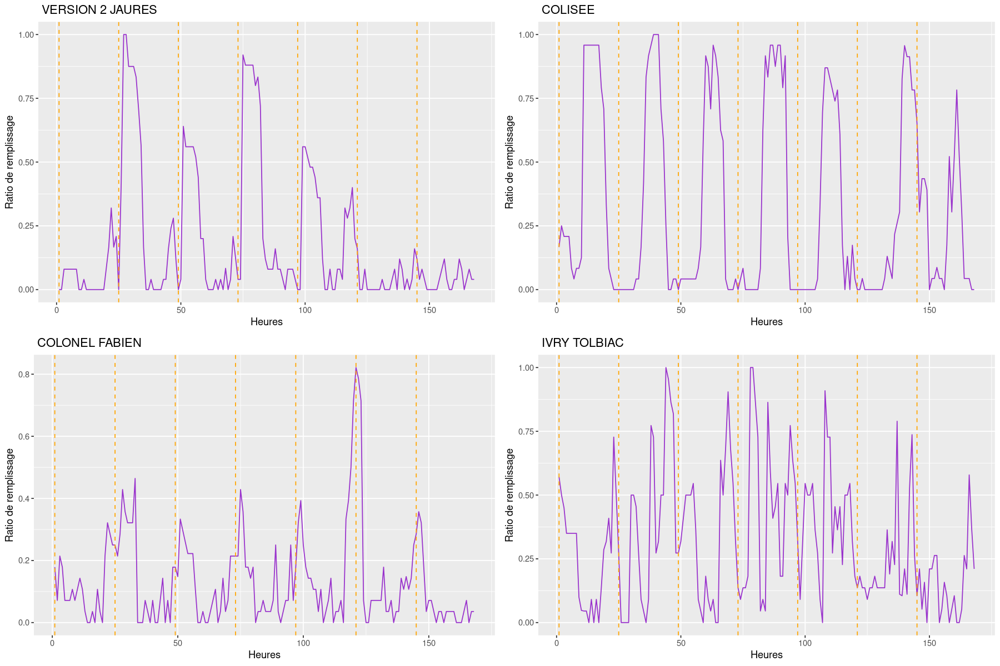

In [145]:
options(repr.plot.width = 15, repr.plot.height = 10)

timeTick = 1 + 24*(0:6)  #  vecteur délimitant les jours

# selection de 4 stations
stations = sample.int(nrow(loading), 4)

df = melt(loading[stations,])

p = list()
for (i in 1:4){
    dfi = df[df$Var1 == velib$names[stations[i]],]
    p[[i]] = ggplot(dfi, aes(x=Var2, y=value)) + 
    
        geom_line(col="darkorchid") + 
        geom_vline(xintercept=timeTick, col="orange", linetype="dashed") +
        labs(title=velib$names[stations[i]], x="Heures", y="Ratio de remplissage")
}
do.call(grid.arrange,p)

Pour une station donnée, nous avons représenté le ratio de changement en fonction du temps et délimité les jours de la semaine (en orange sur les graphiques).
En analysant les graphiques, nous voyons que des tendances se dégagent. Le comportement de remplissage des stations semble changer selon que le jour soit ouvré ou pas et selon qu'on soit le jour ou la nuit. 

### Boxplot des variables

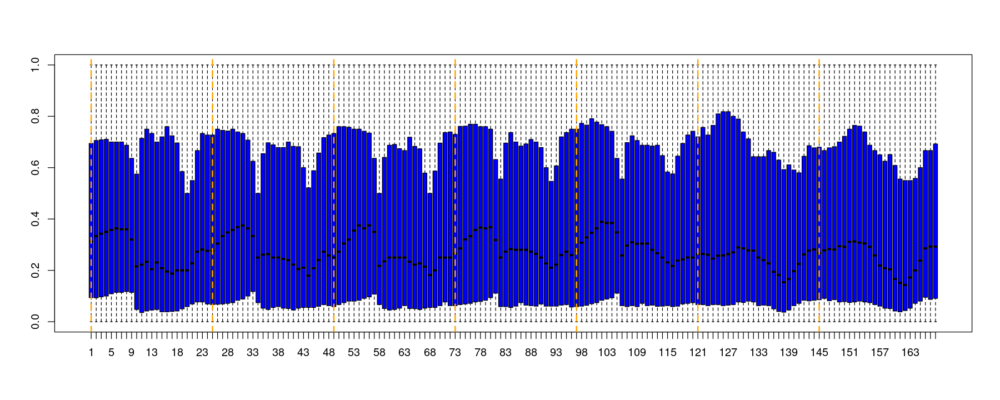

In [146]:
options(repr.plot.width = 15, repr.plot.height = 6)
timeTick = 1 + 24*(0:6)
boxplot(loading,col="blue") 
for (tick in timeTick){
    abline(v=tick, col="orange", lty="dashed", lwd=2)
}

On remarque que toutes les variables ne sont pas à la même échelle. Ce qui traduit le fait que le remplissage ne suit pas la même distribution selon l'heure et le jour. De même, les données ne sont pas symétriques puisque les médianes ne sont pas au milieu des boîtes à moustache. 
Les échelles des valeurs sont toutes entre 0 et 1, ce qui correspond à la plage de valeurs d'un ratio. Il n'y a donc pas de valeurs incohérentes (négatives ou supérieures à 1).
Ce graphique confirme les hypothèses émises plus haut : le comportement des stations dépend du jour de la semaine (ouvré ou non) et du moment dans la journée.


 ### Comportement moyen du remplissage

In [147]:
print('Moyenne de remplissage :')
print(mean(loading))


print('En moyenne, la station la moins remplie est :')
i = which.min(rowMeans(loading)) 
print(rowMeans(loading)[i])



print('En moyenne, la station la plus remplie est : ')
i = which.max(rowMeans(loading))
print(rowMeans(loading)[i])

[1] "Moyenne de remplissage :"
[1] 0.3816218
[1] "En moyenne, la station la moins remplie est :"
 HORNET (BAGNOLET) 
        0.01613284 
[1] "En moyenne, la station la plus remplie est : "
 INSURRECTION AOUT 1944 (IVRY) 
                     0.9193723 


En moyenne, les stations sont remplies à 38%. Pour information, la station "Hornet" est en moyenne la plus vide et la station "Insurrection août 1944" est la plus remplie. En recherche de Vélib, nous vous conseillons donc de vous diriger vers Ivry plutôt que Bagnolet.

Nous allons maintenant nous intéresser au remplissage moyen par station, et le comparer au remplissage moyen de l'entièreté des données.

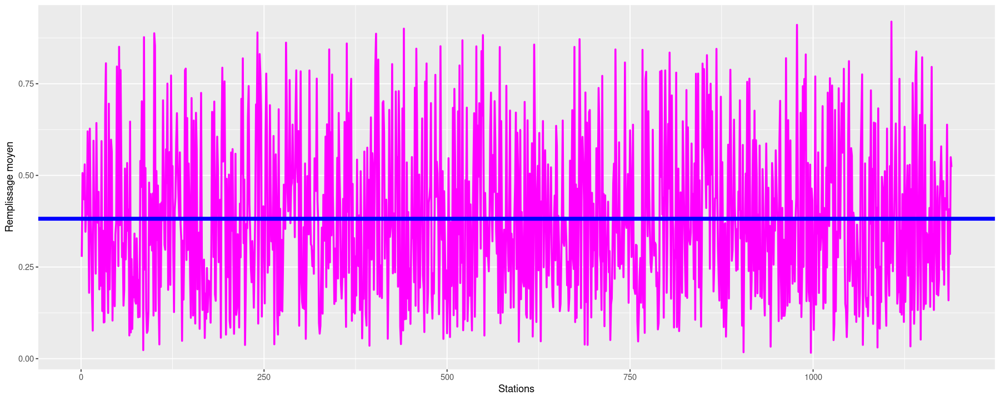

In [148]:
# on trace le remplissage moyen pour chaque station
options(repr.plot.width = 15, repr.plot.height = 6)

df = data.frame(stations = c(1:nrow(loading)), mean = rowMeans(loading))
ggplot(df, aes(x = stations, y= mean)) + 
    geom_line(color = 'magenta', linewidth=1) +
    geom_hline(yintercept = mean(loading), color = 'blue', linewidth=2) +
    labs(x = "Stations", y = "Remplissage moyen")

On observe sur ce graphe une grande disparité parmi les moyennes. En effet, la ligne bleue représente le remplissage moyen de toutes les stations, et le graph rose représente le remplissage moyen par station. De ce graphique on apprend que la moyenne du remplissage est très différente selon les stations. On peut donc dire que les stations n'ont pas le même comportement et se poser la question de la périodicité journalière du remplissage des stations.

           [,1]      [,2]      [,3]      [,4]      [,5]      [,6]      [,7]
 [1,] 0.4015033 0.4000947 0.3932526 0.3973553 0.3965984 0.3905062 0.3861085
 [2,] 0.4087699 0.4110822 0.4063676 0.4085784 0.4086590 0.3961415 0.3896258
 [3,] 0.4117179 0.4159028 0.4168268 0.4192541 0.4174196 0.3935149 0.3874670
 [4,] 0.4151612 0.4205856 0.4212444 0.4245748 0.4251306 0.3970606 0.3916208
 [5,] 0.4171360 0.4217593 0.4243350 0.4282479 0.4307652 0.4042419 0.3987399
 [6,] 0.4216497 0.4265196 0.4286786 0.4328533 0.4371128 0.4076126 0.4074043
 [7,] 0.4198597 0.4265641 0.4287101 0.4314876 0.4353962 0.4129303 0.4129987
 [8,] 0.4157290 0.4216678 0.4240787 0.4252031 0.4278648 0.4132642 0.4150784
 [9,] 0.3846582 0.3864353 0.3871152 0.3844085 0.3883974 0.4092031 0.4126909
[10,] 0.3263314 0.3149544 0.3127752 0.3321468 0.3392637 0.4010459 0.4048583
[11,] 0.3717027 0.3687787 0.3616261 0.3831291 0.3868497 0.3869436 0.3887208
[12,] 0.3830675 0.3779989 0.3745734 0.3916636 0.3966010 0.3726021 0.3709290
[13,] 0.3775

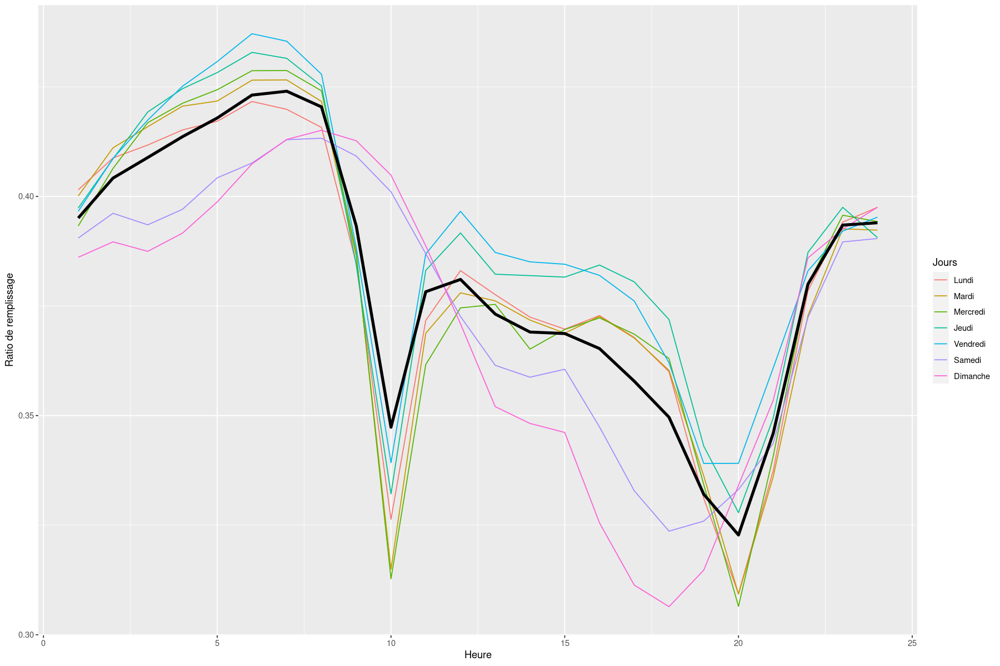

In [149]:
# on trace la moyenne par heure 
moyHJ = colMeans(loading)
moyHJ = matrix(moyHJ, nrow = 24)
moyH         = rowMeans(moyHJ)

print(moyHJ)
moyHJ            = as.data.frame(moyHJ)
colnames(moyHJ)  = list("Lundi", "Mardi", "Mercredi","Jeudi", "Vendredi", "Samedi", "Dimanche")
moyHJ$time_range = c(1:24)
moyHJ            = melt(moyHJ, id='time_range', variable.name='Jours')

moyH            = as.data.frame(moyH)
colnames(moyH)  = list("Hebdomadaire")
moyH$time_range = c(1:24)


options(repr.plot.width = 15, repr.plot.height = 10)

ggplot() + 
    geom_line(data=moyHJ, aes(x=time_range, y=value, color=Jours)) + 
    geom_line(data=moyH, aes(x=time_range, y=Hebdomadaire), linewidth = 1.5)+
    labs(x="Heure", y="Ratio de remplissage")

Ci-dessus nous retrouvons l'évolution heure par heure du remplissage, et ce pour chaque jour de la semaine étudiée. En noir, nous avons la moyenne heure par heure pour tous les jours. De ce graphique nous pouvons tirer comme information que les cinq premiers jours de la semaine ont une allure plutôt similaire, notamment quand on regarde les creux de 10h et 20h, et l'allure des graphes. Les différence viennent prinicpalement du weekend. Ceci confirme que, par la suite, il sera judicieux de séparer la semaine en deux : jours ouvrés et weekend.

### Map des stations 

Installation ggmap

In [150]:
install.packages('ggmap')
library(ggmap)
#8a1c3842-4449-4c60-bb9a-2e274c3bda05
register_stadiamaps("8a1c3842-4449-4c60-bb9a-2e274c3bda05", write = TRUE)

Installation du package dans ‘/home/hountong/R/libs’
(car ‘lib’ n'est pas spécifié)

ℹ Replacing old key (8a1c3842) with new key in /home/hountong/.Renviron



Pour une approche plus visuelle et intuitive, nous avons ensuite décidé d'afficher les stations sur un plan grâce aux coordonnées GPS dont nous disposons. De plus, nous avons fait en sorte que les stations soient identifiables selon leur niveau de remplissage. Pour rappel, plus le remplissage est proche de 1, plus la station aura des Vélib de libres.

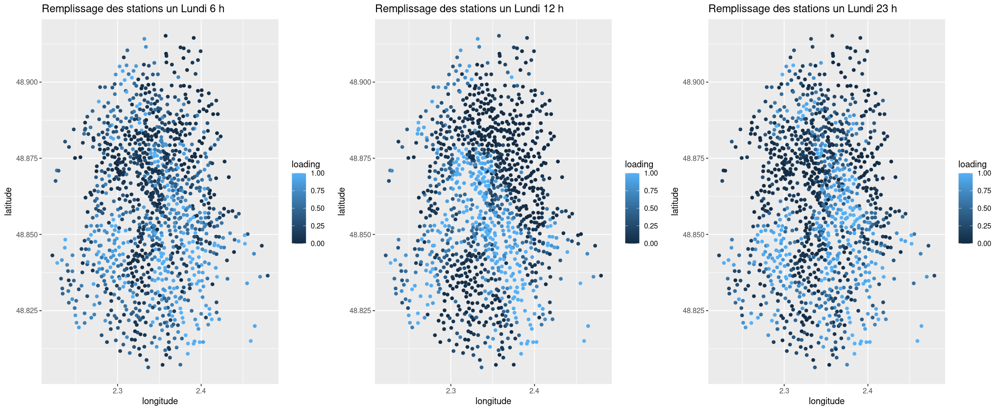

In [151]:
# affichage des stations sur une carte de Paris
options(repr.plot.width = 17, repr.plot.height = 7)
hours = c(6, 12, 23)

dfi = coord
p = list()
for (i in 1:length(hours)){
    dfi$loading = loading[,hours[i]]
    p[[i]] = ggplot(dfi, aes(x=longitude, y=latitude, color=loading)) + 
        geom_point() +
        labs(title = paste("Remplissage des stations un Lundi",hours[i],"h"))
}
do.call(grid.arrange,c(p, ncol=3))

Le lundi on remarque que le remplissage semble être similaire à 6h et à 23h, cependant à midi on remarque que le centre s'éclaircit. Cela signifie qu'entre 6h et midi, les gens sont venus déposer leurs Vélibs en centre-ville, là où la périphérie semble avoir moins de Vélibs à proposer. On peut en déduire une tendance à venir de la périphérie vers le centre-ville entre 6h et midi, et l'inverse entre midi et 23h. Cela correspondrait à venir travailler au centre-ville depuis les périphéries en vélo, et revenir chez soi. Cela semble plausible, surtout dans les cas d'un jour ouvré tel que le lundi.

Nous pouvons affiner un peu plus cette hypothèse en regardant la différence aux horaires des pics que nous avons observé dans les graphiques plus haut : 10h et 20h.

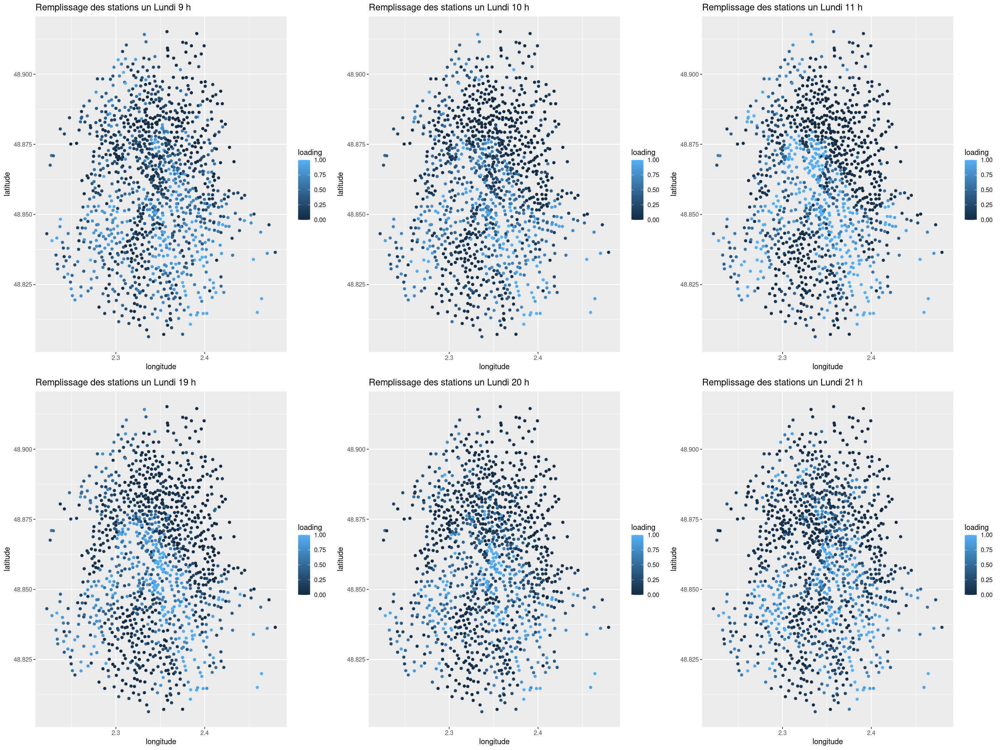

In [152]:
options(repr.plot.width = 20, repr.plot.height = 15)
hours = c(9, 10, 11, 19,20, 21)

dfi = coord
p = list()
for (i in 1:length(hours)){
    dfi$loading = loading[,hours[i]]
    p[[i]] = ggplot(dfi, aes(x=longitude, y=latitude, color=loading)) + 
        geom_point() +
        labs(title = paste("Remplissage des stations un Lundi",hours[i],"h"))
}

do.call(grid.arrange,c(p, ncol=3))

Nous pouvons effectivement noter un fort contraste à 11h entre le centre quasiment rempli, et la périphérie quasiment vide.
De même, à 21h, on remarque le phénomène inverse, le contraste s'amoindrit par rapport à l'après-midi.


Maintenant que nous avons visualisé cette évolution sur un jour, faisons la même chose sur plusieurs jours. Regardons si, pour un horaire donné, le remplissage change selon le jour.

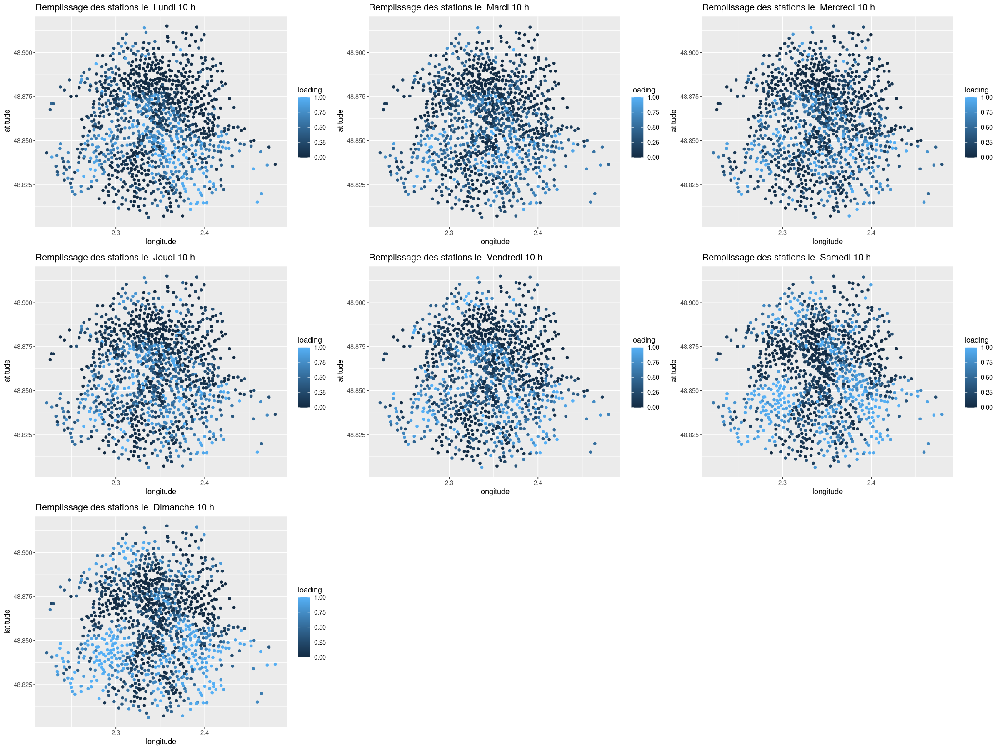

In [153]:
options(repr.plot.width = 20, repr.plot.height = 15)

h = 10
heures = seq(h, 168, 24)
jours  = list("Lundi", "Mardi", "Mercredi","Jeudi", "Vendredi", "Samedi", "Dimanche")

dfi = coord
p = list()
for (i in 1:7){
    dfi$loading = loading[,heures[i]]
    p[[i]] = ggplot(dfi, aes(x=longitude, y=latitude, color=loading)) + 
        geom_point() +
        labs(title = paste("Remplissage des stations le ", jours[i], h,"h"))
}

do.call(grid.arrange,c(p, ncol=3))

On remarque qu'à 10h, il y a plus de Vélibs en périphérie les samedis et dimanches que les jours ouvrés. Ce qui semble cohérent puisque les weekends, généralement, les personnes ne vont pas au travail et n'empruntent donc pas de Vélibs pour se déplacer des périphéries vers le centre. 

Voici la moyenne du remplissage des stations sur le plan de Paris.

ℹ Using `zoom = 12`

ℹ © Stadia Maps © Stamen Design © OpenMapTiles © OpenStreetMap contributors.

ℹ Using `zoom = 12`

ℹ © Stadia Maps © Stamen Design © OpenMapTiles © OpenStreetMap contributors.

ℹ Using `zoom = 12`

ℹ © Stadia Maps © Stamen Design © OpenMapTiles © OpenStreetMap contributors.



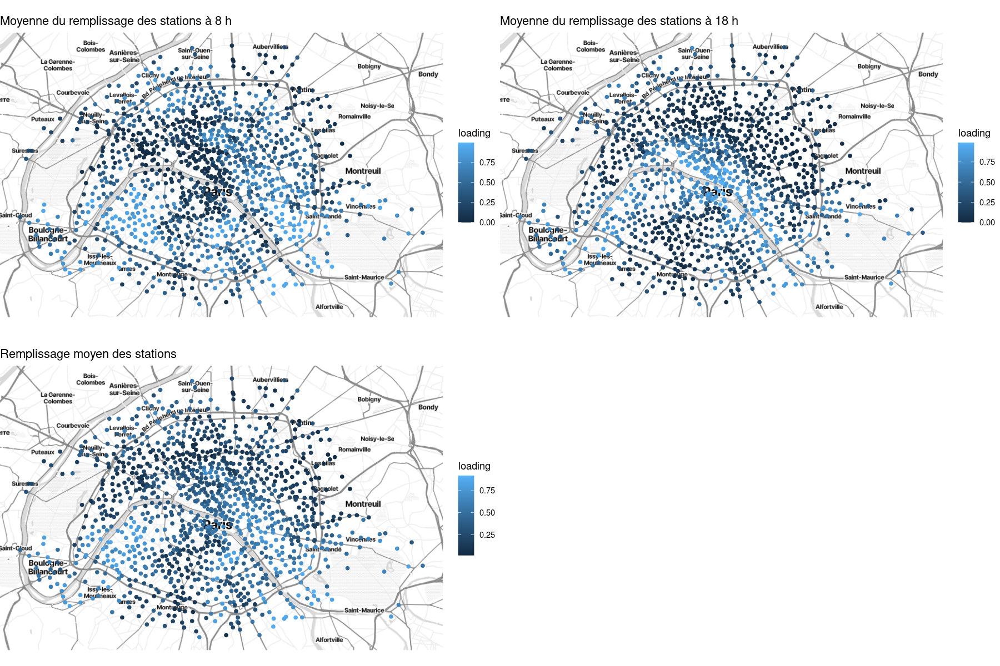

In [154]:
options(repr.plot.width = 15, repr.plot.height =10)
p=list()
h     = 8
heures = seq(h, 168, 24)
R = rowMeans(loading[,heures])

df = coord
df$loading = R


p[[1]]=qmplot(data=df, longitude, latitude, color=loading) +
    labs(title = paste('Moyenne du remplissage des stations à',h,'h'))
h     = 18
heures = seq(h, 168, 24)
R = rowMeans(loading[,heures])

df = coord
df$loading = R


p[[2]]=qmplot(data=df, longitude, latitude, color=loading) +
    labs(title = paste('Moyenne du remplissage des stations à',h,'h'))

df$loading = rowMeans(loading)
p[[3]]=qmplot(data=df, longitude, latitude, color=loading)  +
        labs(title = paste("Remplissage moyen des stations "))

do.call(grid.arrange,c(p, ncol=2))


On remarque qu'il y a une migration des vélibs qui se produit dans la journée. Au matin (8h), le centre de Paris est vide tandis que les vélos sont concentrés en périphérie. Ils sont déplacés dans la journée, et au soir (18h), ils sont concentrés dans les stations du centre de Paris. Cependant, malgré ce phénomène cyclique, en moyenne, les stations se situant dans les lieux les plus fréquentées de la ville sont plus remplies.

Maintenant que nous avons étudié l'évolution selon l'heure et visualisé ce remplissage sur un plan, il serait intéressant de voir si l'altitude des stations joue un rôle dans leur remplissage.

### Altitude des stations 

In [155]:
# definition des parametres hill
nb_pente <- sum(coord$bonus==1)
nb_hill <- sum(coord$bonus==0)
print(nb_pente)
print ("Proportion des stations situées en altitude:")
print(nb_pente/(nb_pente+nb_hill))

[1] 127
[1] "Proportion des stations situées en altitude:"
[1] 0.1068124


127 soit 10,7% des stations sont situées en altitude à Paris.


Plaçons les sur une map pour plus de clarté.

ℹ Using `zoom = 12`

ℹ © Stadia Maps © Stamen Design © OpenMapTiles © OpenStreetMap contributors.



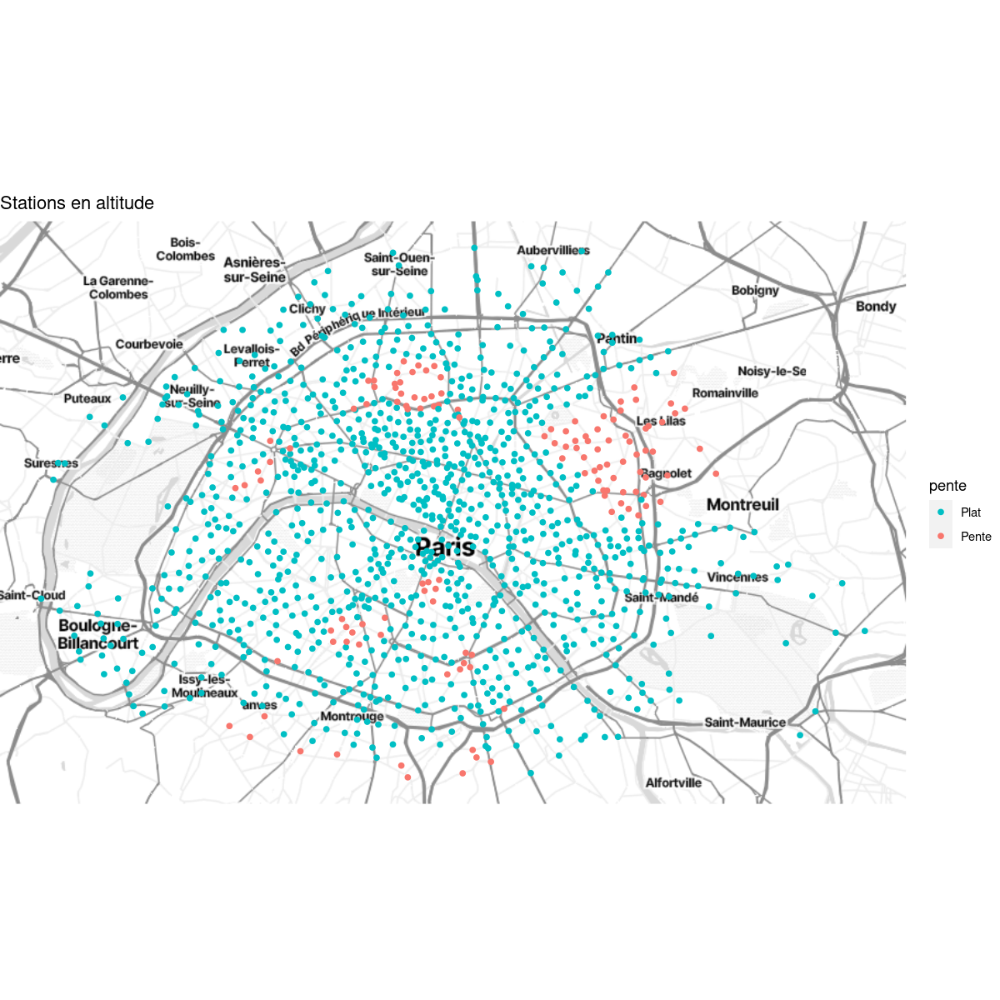

In [156]:
options(repr.plot.width = 10, repr.plot.height = 10)
coord$pente = as.factor(coord$bonus)
levels(coord$pente) = c('Plat','Pente')
qmplot(data=coord, longitude, latitude, color=pente) +

    scale_color_hue(direction = -1) +
    labs(title = 'Stations en altitude')

Les stations en altitudes sont localisées dans sept zones différentes. On remarque également dans l'ensemble, une agglomération de ces stations.

Passons désormais à l'étude du remplissage de ces stations par rapport aux autres, pour voir si des tendances se dégagent. Pour cela, nous allons représenter la moyenne de remplissage des stations, tout en distinguant si elles sont en altitude ou pas.

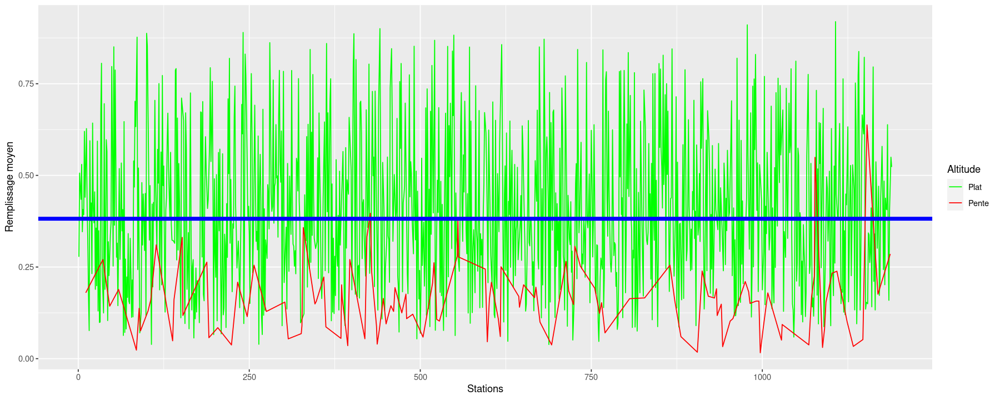

In [157]:
options(repr.plot.width = 15, repr.plot.height = 6)


df = data.frame(stations = c(1:nrow(loading)), mean = rowMeans(loading),bonus=coord$bonus)
# Calculer les moyennes pour bonus = 1 et bonus = 0
mean_bonus_1 <- mean(df[df$bonus == 1, "mean"])
mean_bonus_0 <- mean(df[df$bonus == 0, "mean"])

ggplot(df, aes(x = stations, y = mean, group = bonus, color = factor(bonus))) +
geom_line() +
geom_hline(yintercept = mean(loading), color = 'blue', linewidth=2) +
labs(x = "Stations", y = "Remplissage moyen", color = "Altitude") +
scale_color_manual(values = c("green", "red"), labels = c("Plat", "Pente"))



On remarque que la moyenne de remplissage des stations situées en altitude est souvent faible. Ceci est surement lié au fait que monter une pente avec un vélo est difficile. Les personnes auront donc tendance à moins fréquenter les stations situées en altitude.

Nous allons visualiser cette hypothèse sur une carte de Paris.

ℹ Using `zoom = 12`

ℹ © Stadia Maps © Stamen Design © OpenMapTiles © OpenStreetMap contributors.

ℹ Using `zoom = 12`

ℹ © Stadia Maps © Stamen Design © OpenMapTiles © OpenStreetMap contributors.

ℹ Using `zoom = 12`

ℹ © Stadia Maps © Stamen Design © OpenMapTiles © OpenStreetMap contributors.



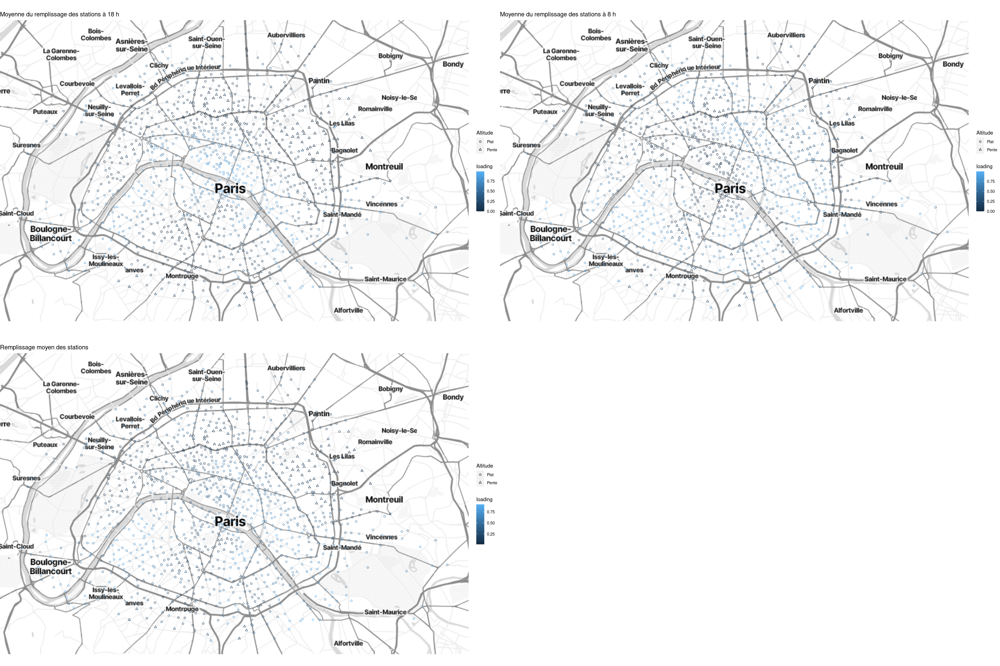

In [158]:
options(repr.plot.width = 30, repr.plot.height =20)
p=list()
h     = 18
heures = seq(h, 168, 24)
R = rowMeans(loading[,heures])

df = coord
df$loading = R

p[[1]]=qmplot(data=df, longitude, latitude, color=loading,shape=factor(coord$pente) ) +
     scale_shape_manual(values=c(1,2) )+
    
    labs(title = paste('Moyenne du remplissage des stations à',h,'h'),shape="Altitude")
h     = 8
heures = seq(h, 168, 24)
R = rowMeans(loading[,heures])

df = coord
df$loading = R

p[[2]]=qmplot(data=df, longitude, latitude, color=loading,shape=factor(coord$pente)) +
 scale_shape_manual(values=c(1,2) )+
    labs(title = paste('Moyenne du remplissage des stations à',h,'h'),shape="Altitude")

df$loading = rowMeans(loading)
p[[3]]=qmplot(data=df, longitude, latitude, color=loading,shape=factor(coord$pente))  +
 scale_shape_manual(values=c(1,2) )+
        labs(title = paste("Remplissage moyen des stations "),shape="Altitude")

do.call(grid.arrange,c(p, ncol=2))


On a vérifié graphiquement que la moyenne de remplissage des stations situées en altitude est souvent faible.

**Conclusion:**
De cette première étude des données, on retient que des tendances se dégagent selon la zone géographique des stations : stations au centre ville ou en altitude. De plus, le comportement des utilisateurs n'est pas le même pour un jour ouvré ou non. 
Ceci est une bonne intuition des différents profils qui devraient se dégager de notre analyse.

## II- Analyse en Composantes Principales (ACP)

Notre DataFrame loading contient 168 variables. Ce qui fait beaucoup de variables à analyser. Nous allons donc faire une Analyse en Composantes Principales pour réduire leur nombre.

In [159]:
library(FactoMineR)
library(factoextra)

In [160]:
library(ggpubr)  #pour récupérer la fonction ggarrange 

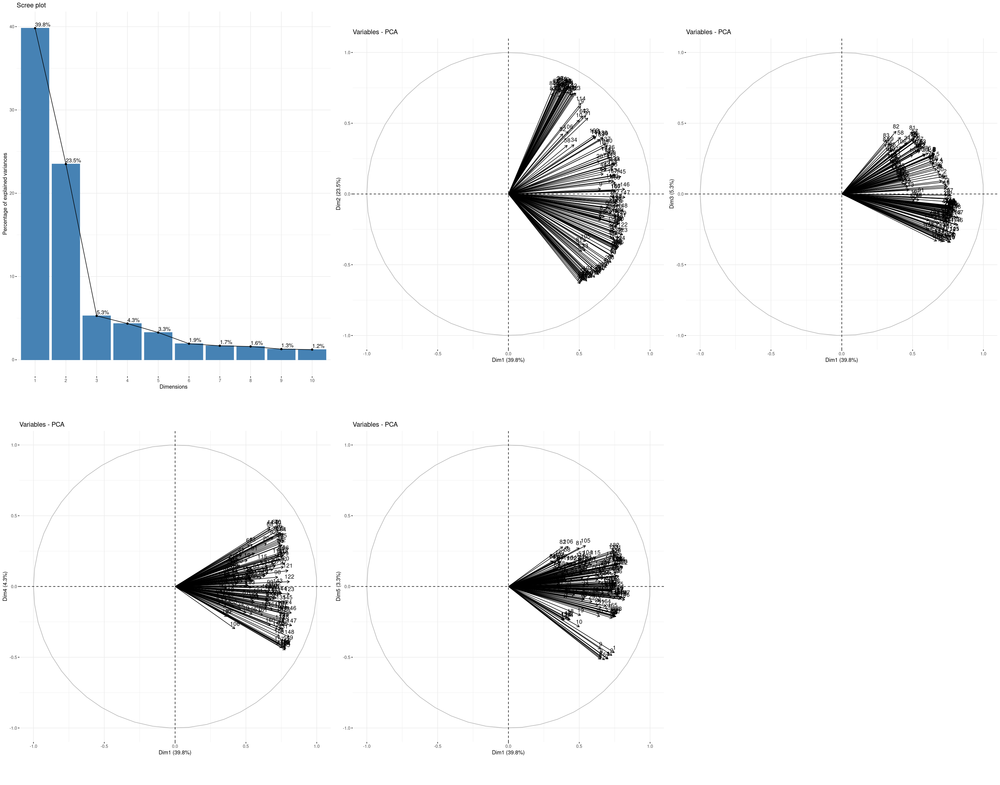

In [161]:

options(repr.plot.width = 28, repr.plot.height = 22)
# on centre et on réduit 
loading_scaled = scale(loading, scale=T, center=T)
pca = PCA(loading_scaled, scale.unit = TRUE, graph=FALSE)

# Avec ggarrange : affichage du pourcentage de variance expliquée et du graph des variables

ggarrange(
    fviz_eig(pca,addlabels = TRUE), 
    fviz_pca_var(pca,axes=c(1,2)),
    fviz_pca_var(pca,axes=c(1,3)),
    fviz_pca_var(pca,axes=c(1,4)),
    fviz_pca_var(pca,axes=c(1,5))
    
)

On choisit de garder cinq dimensions pour expliquer environ 76% de la variance. En effet, la règle suggère de garder environ 80% de l'inertie dans l'idéal, mais pour arriver à ce pourcentage ici on devrait garder huit dimensions. Ceci rendrait notre analyse difficile.

Les projections des variables sur les différents plans factoriels sont illisibles. Comme il s'agit de variables temporelles, nous allons tracer leur corrélation en fonction de chaque dimension. 

integer(0)

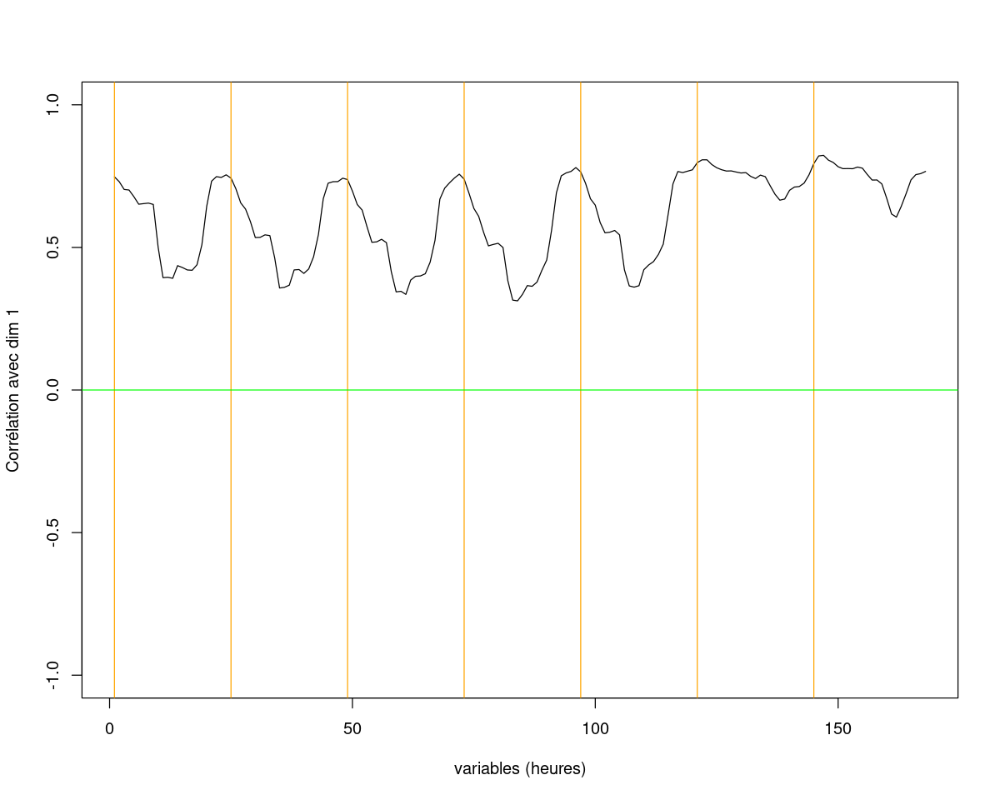

integer(0)

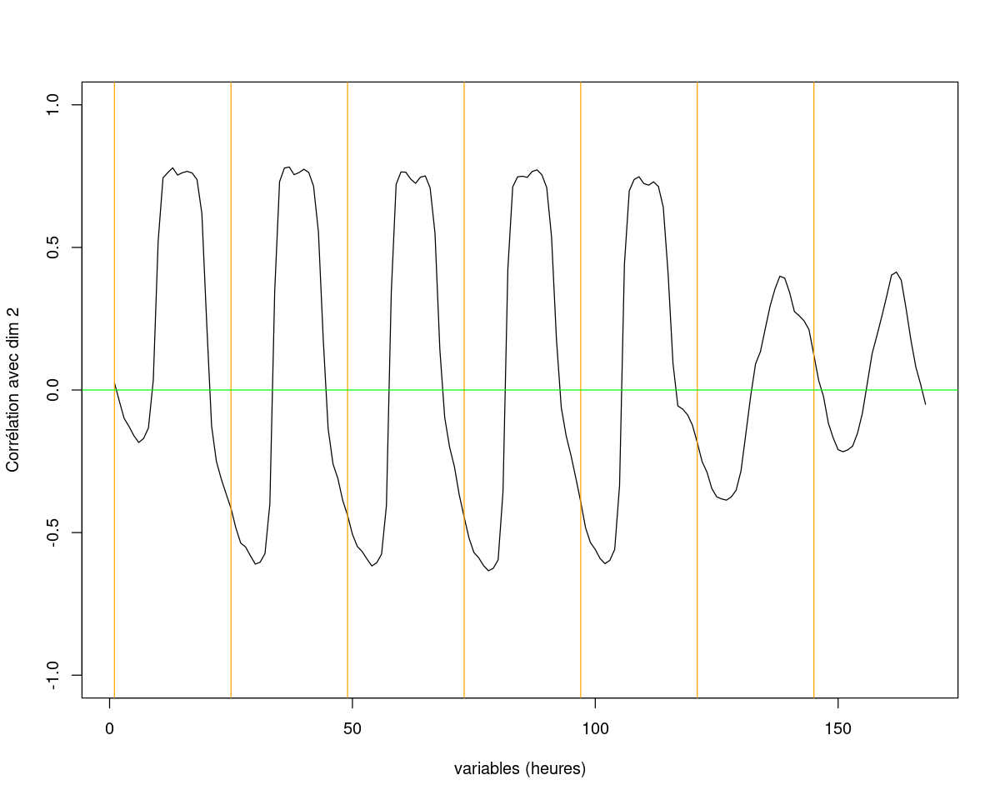

integer(0)

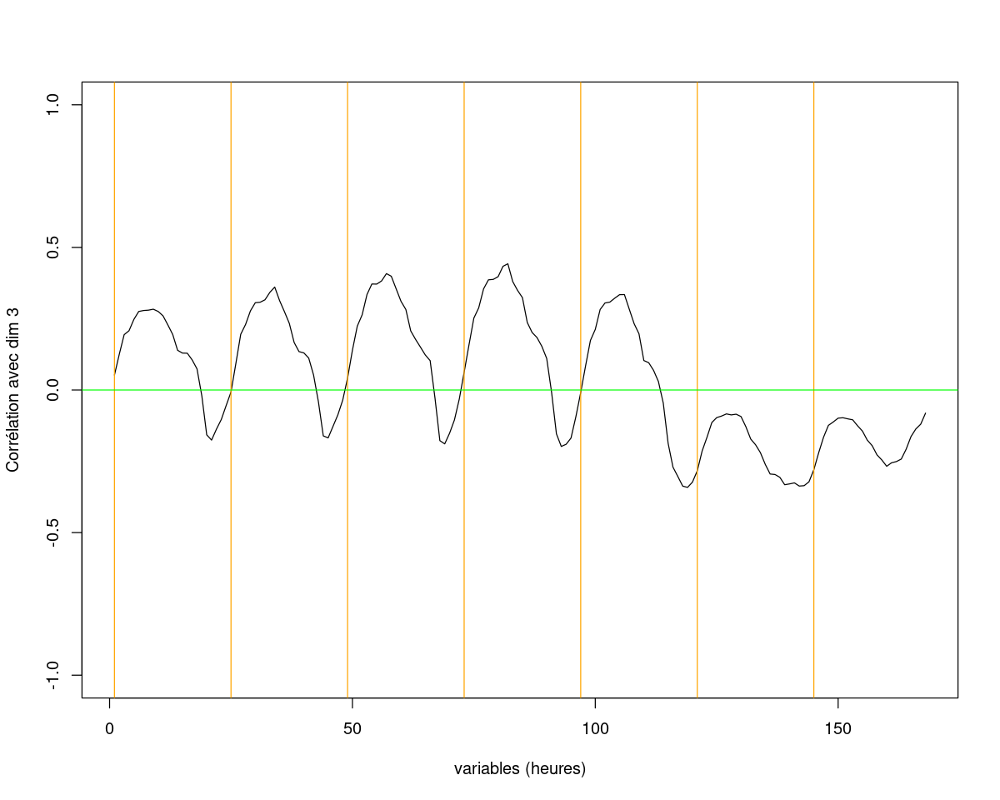

In [162]:
options(repr.plot.width = 10, repr.plot.height = 8)
timeTick = 1 + 24*(0:6)  #  vecteur délimitant les jours


plot(pca$var$coord [,1],type='l',xlab="variables (heures)",ylab="Corrélation avec dim 1",ylim=c(-1,1))  + 
abline(v=timeTick, col="orange")+
abline(h=0, col="green")


plot(pca$var$coord [,2],type='l',xlab="variables (heures)",ylab="Corrélation avec dim 2",ylim=c(-1,1))  + 
abline(v=timeTick, col="orange")+
abline(h=0, col="green")


plot(pca$var$coord [,3],type='l',xlab="variables (heures)",ylab="Corrélation avec dim 3",ylim=c(-1,1))  + 
abline(v=timeTick, col="orange")+
abline(h=0, col="green")


On remarque que toutes les variables sont correlées positivement avec la composante 1. Cette composante mesure donc le niveau global de remplissage des stations.  
Les variables représentant les horaires de travail (8h - 19h) sont corrélées positivement avec la dimension 2 tandis que les variables correspondant aux horaires de repos (20h-7h) sont liées négativement à la dimension 2. Elle représente donc la distinction entre les taux de remplissage en temps de travail ou non.

Les variables correspondant au samedi, au dimanche et aux jours ouvrés de 19h à 23h ont toutes une corrélation négative avec la dimension 3. Ces horaires semblent liés aux sorties hors travail. Au contraire, les variables correspondant aux jours ouvrés de 0h à 19h sont correlées positivement avec la dimension 3. Elle représente donc le profil des utilisations des vélibs hors cadre professionnel.

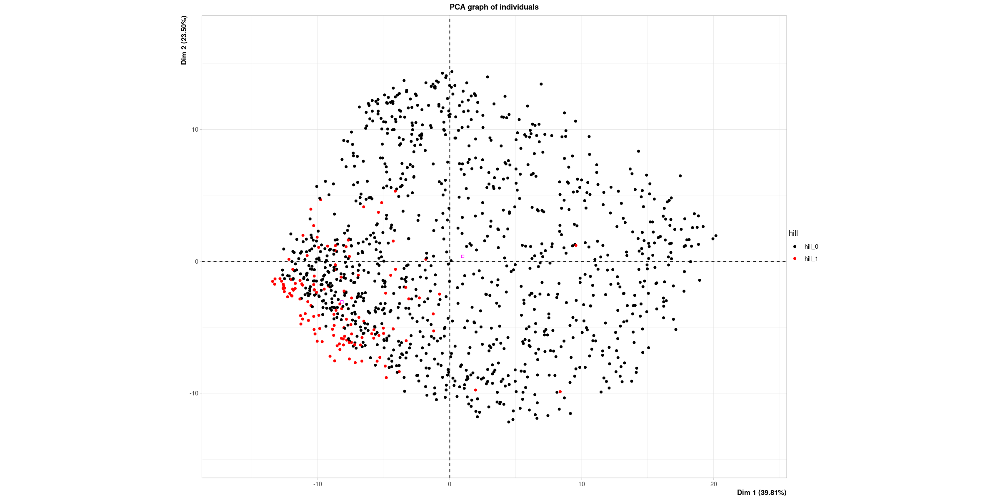

In [163]:
# graph des individus
options(repr.plot.width = 20, repr.plot.height = 10)
xhill = data.frame(loading_scaled, hill=as.factor(velib$bonus))
mpca2= PCA(xhill, scale.unit=TRUE, graph=FALSE, quali.sup=169)
plot(mpca2, axes=c(1,2), choix="ind", habillage=169,label="none")

Les individus localisés sur une colline sont regroupés sur le graphique (ce sont les points rouge). Ils sont corrélés négativement avec les dimensions 1 et 2. Ce qui traduit le fait que ces stations sont en moyenne moins remplies que celles qui ne sont pas en altitude. De plus, elles sont plutôt utilisées pendant les horaires de repos. 

## III- Clustering

Il s'agit ici de regrouper dans une même classe les stations de vélos qui présentent une certaine similitude dans leur usage. Pour cela, nous allons mettre en opposition divers algorithmes de clustering: K-means, Hierachical clustering et Gaussian Mixture Models.

### K-Means appliqué aux données sans ACP préalable

L'algorithme k-means est un algoithme itératif basé sur la distance, dont l'objectif est de minimiser l'inertie intra-classe à chaque étape.

Nous allons commencer par chercher le nombre de clusters optimal pour classer les stations de Vélibs.

Pour l'initialisation des centroïdes, nous choisissons la méthode k-means++ dans l'optique d'avoir des clusters bien séparés. 

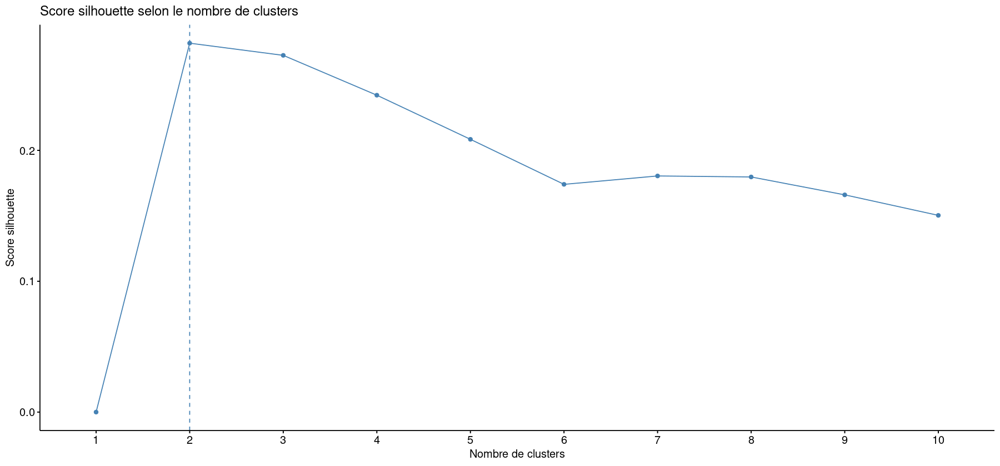

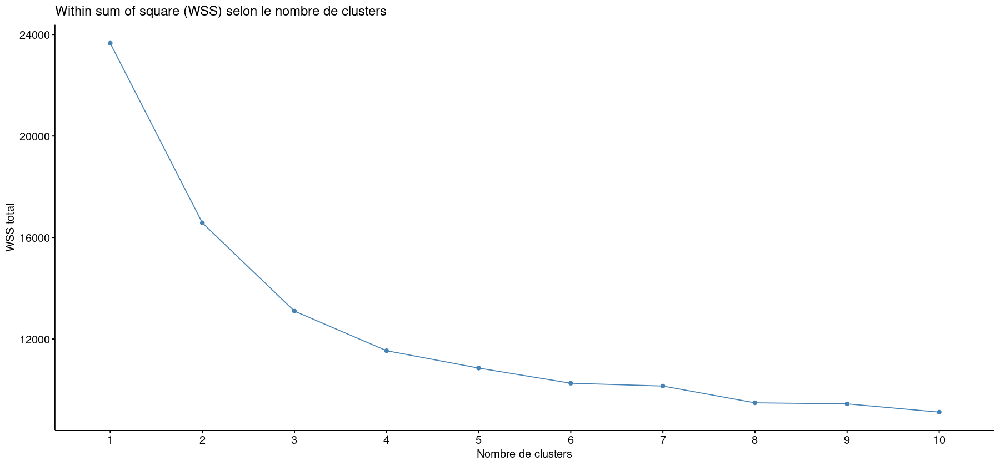

In [164]:
# choix du nombre de clusters 
options(repr.plot.width = 15, repr.plot.height = 7)
library(cluster)
fviz_nbclust(loading,kmeans,method="silhouette")+
     ggtitle("Score silhouette selon le nombre de clusters")+
     labs(x="Nombre de clusters", y= "Score silhouette")
fviz_nbclust(loading, FUNcluster=kmeans, method="wss") +
    ggtitle("Within sum of square (WSS) selon le nombre de clusters")+
    labs(x="Nombre de clusters", y= "WSS total")

En utilisant le score silhouette, le nombre de cluster optimal est 2. Cependant, avec l'indice de distorsion, on utiliserait 4 clusters si on initialise le nombre de clusters minimal à 2, et 6 clusters si le nombre minimal est 3. Nous allons chercher à comprendre ce que représente chaque classe dans le cas de 2, 4 ou 6 clusters.

#### Pour k=2

In [165]:
k=2
reskmeans = kmeans(loading,k)


On compare désormais avec la variable bonus.

In [166]:
tbl = table(velib$bonus, reskmeans$cluster)
paste('Matrice de confusion:')
print(tbl)

[1] "Matrice de confusion:"

   
      1   2
  0 597 465
  1 124   3


Cette classification n'isole pas les stations en fonction de leur altitude. Cependant, la majorité des stations en altitude sont dans le cluster 1. Celles ci ayant une moyenne de remplissage plus faible, on a l'intuition que ce clustering fait une classification des vélos très utlisés en moyenne, et ceux moins utlisés.

In [167]:
# on regarde selon la moyenne de remplissage
xniv <-data.frame(loading, niv=as.factor(rowMeans(loading) > mean(loading)))
tbl = table(xniv$niv, reskmeans$cluster)
print(tbl)

       
          1   2
  FALSE 626  14
  TRUE   95 454


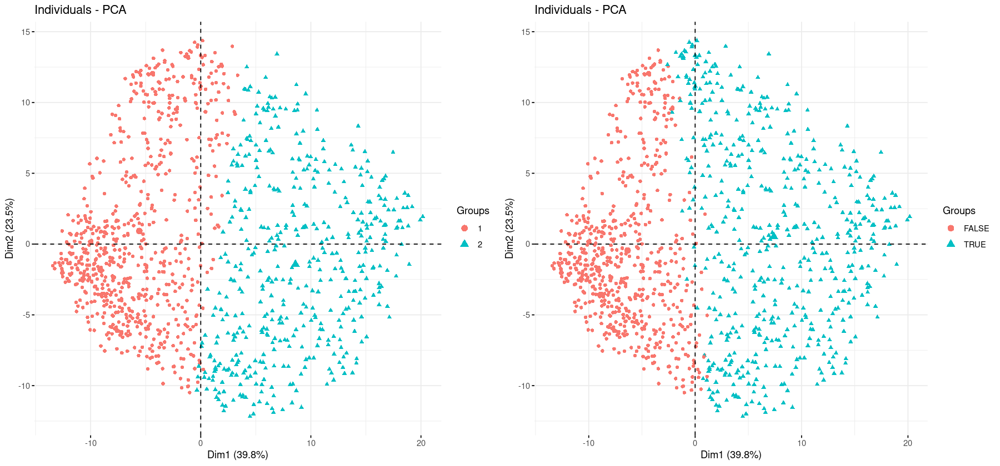

In [168]:
grid.arrange(
   
    fviz_pca_ind(pca, axes=c(1,2), geom=c("point"), habillage=as.factor(reskmeans$cluster)),
    fviz_pca_ind(pca, axes=c(1,2), geom=c("point"), habillage=xniv$niv),
    ncol=2

)

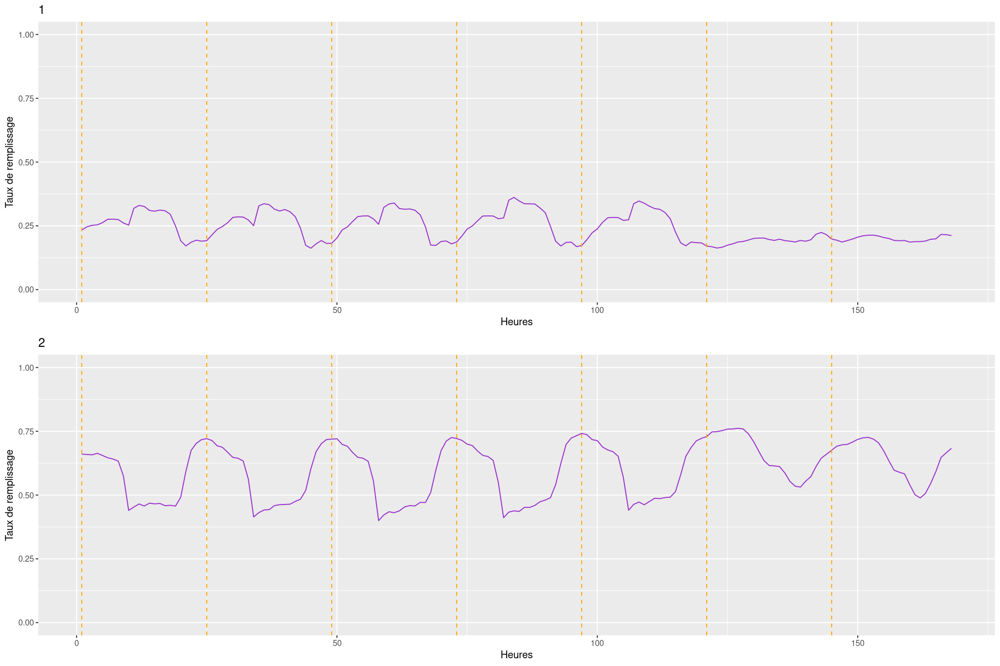

In [169]:
# affichage du taux de remplissage des centroïdes en fonction du temps
barycentres =reskmeans$centers
options(repr.plot.width = 15, repr.plot.height = 10)


timeTick = 1 + 24*(0:6)  #  vecteur délimitant les jours
p = list()
for (i in 1:2){
    dfi = data.frame(times= seq(1,168), value=barycentres[i,])
    p[[i]] = ggplot(dfi, aes(x=times, y=value)) + 
        geom_line(col="darkorchid") + 
        geom_vline(xintercept=timeTick, col="orange", linetype="dashed") +
        ylim(0,1)+
        labs(title= i, x="Heures", y="Taux de remplissage")
}
do.call(grid.arrange,p)

La classification avec deux clusters en utilisant k-means permet de séparer les stations en fonction de leur remplissage moyen. En effet, la table de contingence montre une bonne isolation des stations moins remplies.

L'affichage du taux de remplissage au cours du temps des centroïdes des deux clusters confirme cette idée: le premier cluster regroupe les stations les plus remplies en moyenne et les stations dans le cluster 2 sont celles qui sont les moins remplies.

#### Pour k=4

In [170]:
k=4
reskmeans2 = kmeans(loading,k)

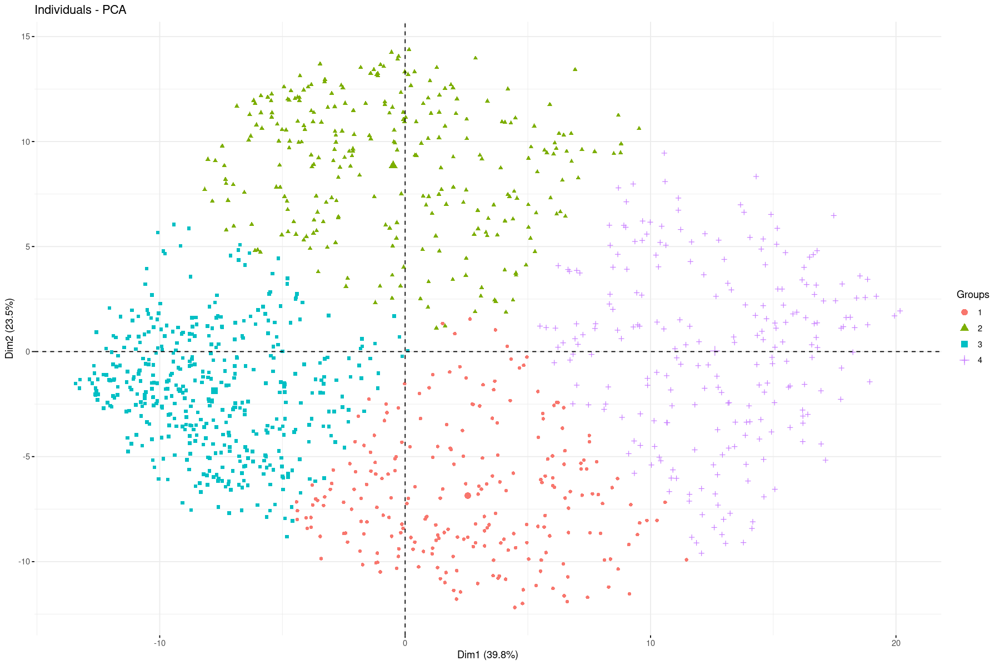

In [171]:
# on affiche le graph des individus
fviz_pca_ind(pca, axes=c(1,2), geom=c("point"), habillage=as.factor(reskmeans2$cluster))

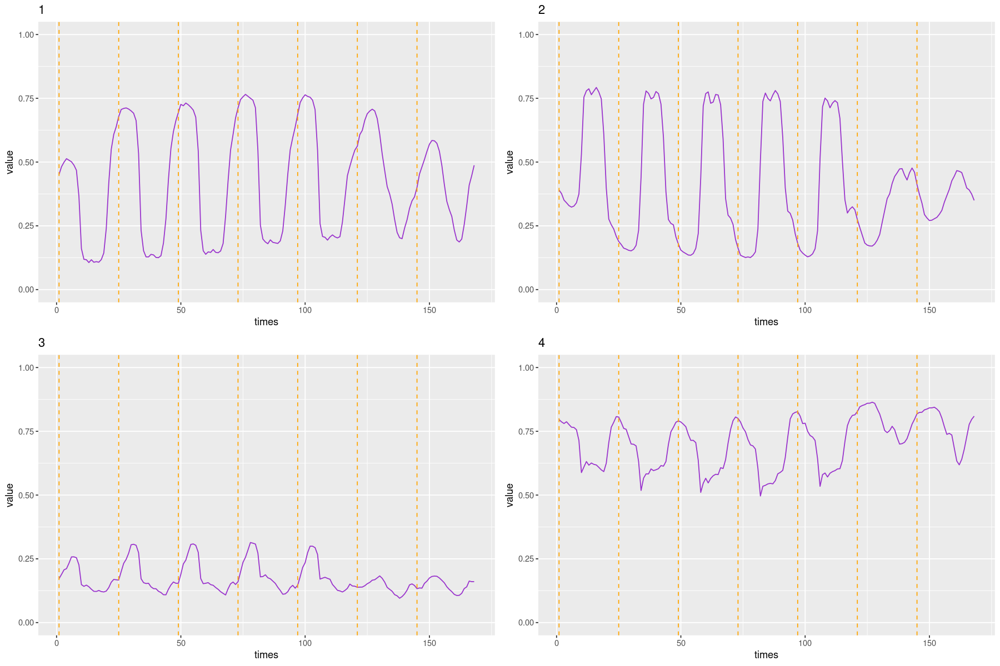

In [172]:
# affichage du taux de remplissage des centroïdes en fonction du temps
barycentres =reskmeans2$centers
options(repr.plot.width = 15, repr.plot.height = 10)


timeTick = 1 + 24*(0:6)  #  vecteur délimitant les jours
p = list()
for (i in 1:4){
    dfi = data.frame(times= seq(1,168), value=barycentres[i,])
    p[[i]] = ggplot(dfi, aes(x=times, y=value)) + 
        geom_line(col="darkorchid") + 
        geom_vline(xintercept=timeTick, col="orange", linetype="dashed") +
        ylim(0,1)+
        labs(title= i)
}
do.call(grid.arrange,p)

Les clusters sont bien séparés dans le premier plan factoriel et isolent 4 profils d'utilisation :
- les stations remplies entre 20h et 7h du lundi au vendredi et le weekend (horaires de repos)
- les stations les moins remplies 
- les stations les plus remplies
- les stations remplies principalement entre 8h et 19h les jours ouvrés et pas les weekends (horaires actifs)


#### Pour k=6

In [173]:
k=6
reskmeans3 = kmeans(loading,k)

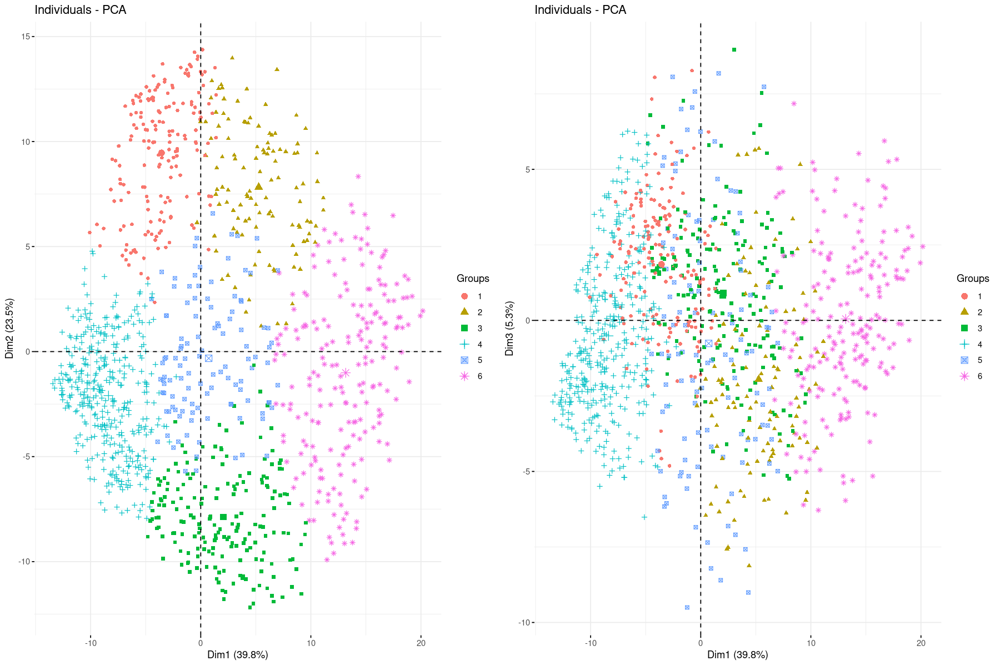

In [174]:
# on affiche le graph des individus
grid.arrange(
   
    fviz_pca_ind(pca, axes=c(1,2), geom=c("point"), habillage=as.factor(reskmeans3$cluster)),
    fviz_pca_ind(pca, axes=c(1,3), geom=c("point"), habillage=as.factor(reskmeans3$cluster)),
    ncol=2

)

En représentant les individus dans l'espace d'ACP selon la classe à laquelle ils appartiennent, on remarque que les  clusters semblent bien séparés dans le premier plan factoriel (1,2)  

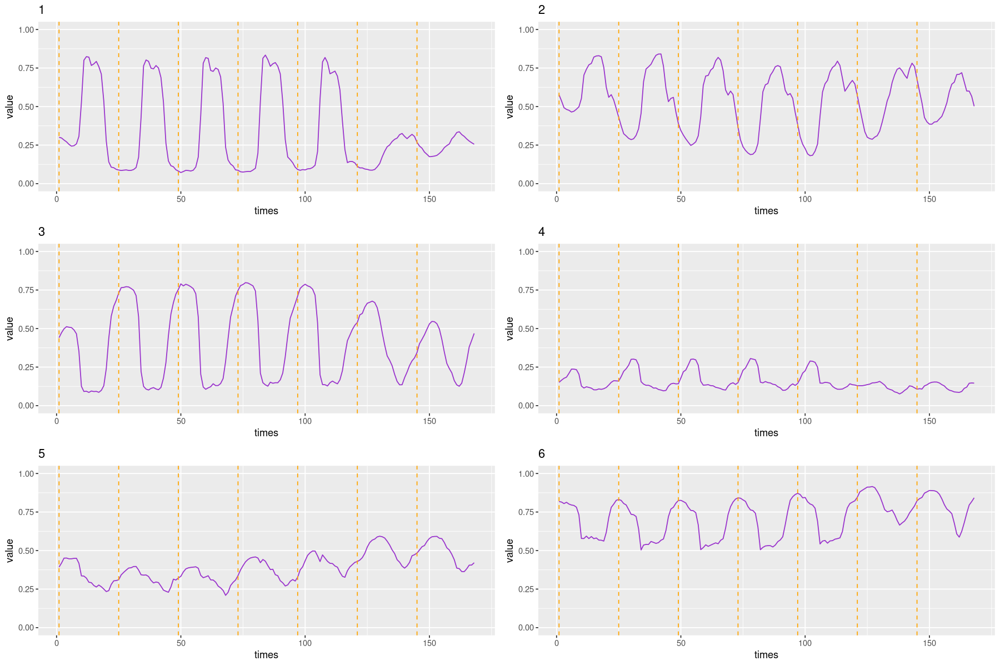

In [175]:
# affichage du taux de remplissage des centroïdes en fonction du temps
barycentres =reskmeans3$centers
options(repr.plot.width = 15, repr.plot.height = 10)


timeTick = 1 + 24*(0:6)  #  vecteur délimitant les jours
p = list()
for (i in 1:6){
    dfi = data.frame(times= seq(1,168), value=barycentres[i,])
    p[[i]] = ggplot(dfi, aes(x=times, y=value)) + 
        geom_line(col="darkorchid") + 
        geom_vline(xintercept=timeTick, col="orange", linetype="dashed") +
        ylim(0,1)+
        labs(title= i)
}
do.call(grid.arrange,p)

En combinant la visualisation des clusters dans l'espace d'ACP et la représentation des barycentres de chaque clusters, on peut dire que le fait d'avoir augmenter le nombre de cluster apporte une certaine nuance dans le découpage. Ici les clusters représentent: 

- les stations vides le jour et remplies la nuit
- les stations moins remplies le week-end et les horaies actifs, qu'à un autre moment de la semaine 
- les stations moins remplies le week-end qu'à un autre moment de la semaine, et remplies dans la journée mais pas dans la soirée
- les stations les plus remplies    
- les stations les plus vides 
- les stations avec un remplissage moyen à tout moment



Après réflexion nous décidons que le cas k=4 est plus optimal. En effet, dans le cas k=6 les disticntions des cas d'utilisation sont trop fines, le cas k=4 suffit pour une bonne interprétation.

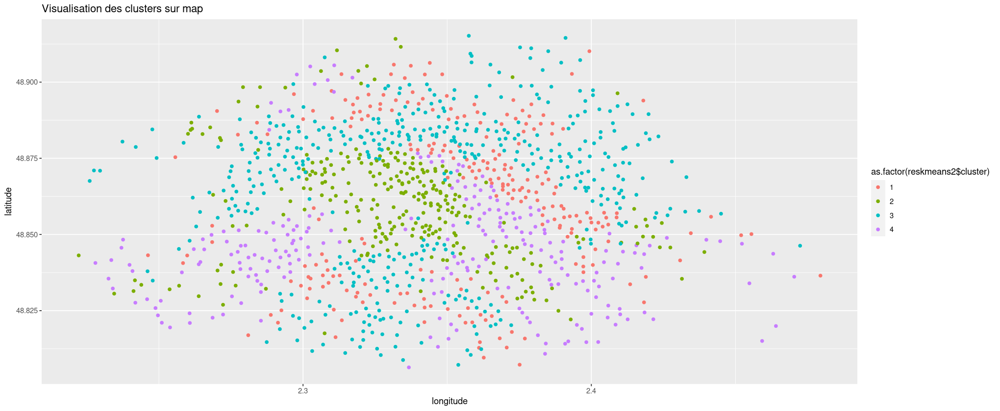

In [176]:
# affichage sur la map de Paris
options(repr.plot.width = 17, repr.plot.height = 7)


dfi = coord
p = list()
dfi$loading = loading
ggplot(dfi, aes(x=longitude, y=latitude, color=as.factor(reskmeans2$cluster))) + 
    geom_point() +
    labs(title = paste("Visualisation des clusters sur map"))


En représentaant les sations sur une carte, on remarque que les comportements intuités lors de l'analyse descriptive sont prouvés par le clustering réalisé. En particulier, on retrouve que les stations du centre-ville sont remplies aux horaires actifs et vides aux moments de repos.

### Utilsation des données dans l'espace d'ACP

L'ACP nous a permis de concentrer la majorité de l'information de notre jeu de données sur cinq dimensions. Nous allons donc faire une classification en nous appuyant sur ces dernières.

In [177]:
# préparation des données réduites
pca_result=prcomp(loading_scaled)
loading_pca <- predict(pca_result)
loading_reduced=loading_pca[,1:5]

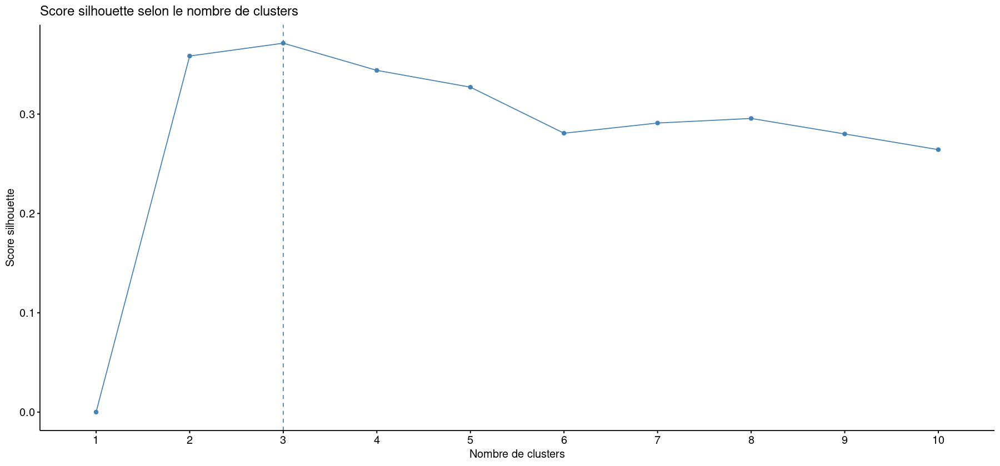

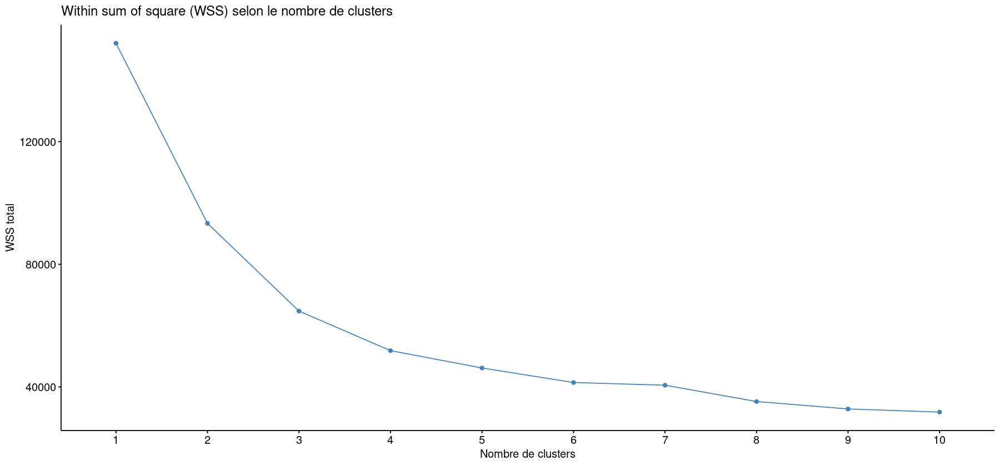

In [178]:
# choix du nombre de clusters 
options(repr.plot.width = 15, repr.plot.height = 7)

fviz_nbclust(loading_reduced,kmeans,method="silhouette")+
     ggtitle("Score silhouette selon le nombre de clusters")+
     labs(x="Nombre de clusters", y= "Score silhouette")
fviz_nbclust(loading_reduced, FUNcluster=kmeans, method="wss") +
    ggtitle("Within sum of square (WSS) selon le nombre de clusters")+
    labs(x="Nombre de clusters", y= "WSS total")

On remarque qu'en fonction de la métrique utilisée, le nombre de clusters optimal est 3, 4 ou 6.

Notre analyse se resteindra au cas k=4 qui nous permet d'avoir une segmentation plus interprétable.

In [179]:
k=4
reskmeans_pca = kmeans(loading_reduced,k)

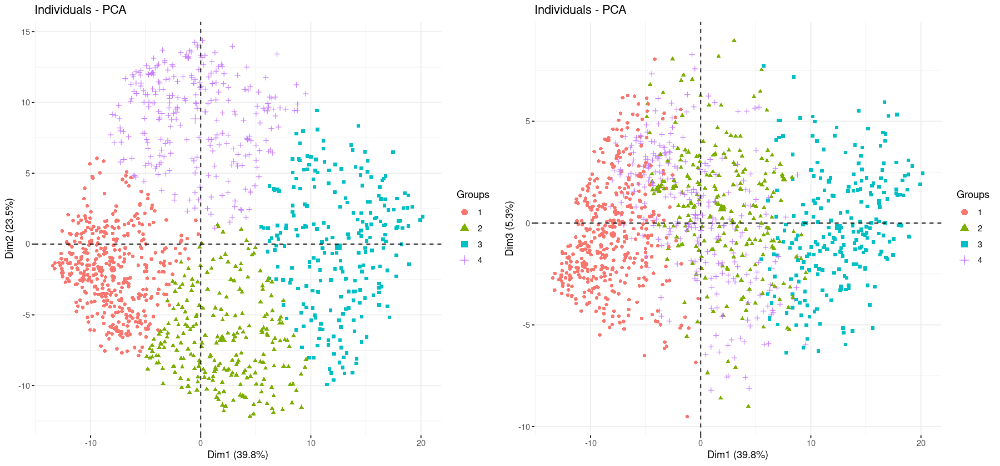

In [180]:
# on affiche le graphe des individus
grid.arrange(
   
    fviz_pca_ind(pca, axes=c(1,2), geom=c("point"), habillage=as.factor(reskmeans_pca$cluster)),
    fviz_pca_ind(pca, axes=c(1,3), geom=c("point"), habillage=as.factor(reskmeans_pca$cluster)),
    ncol=2

)

On obtient la même chose que dans le cas précédent

Nous constatons que le clustering en utilisant les données avec traitement ACP est le même qu'en utilisant les données initiales.

Afin d'analyser la classification faite, nous allons afficher pour chaque cluster l'évolution du chargement au cours du temps pour des individus pris aléatoirement.

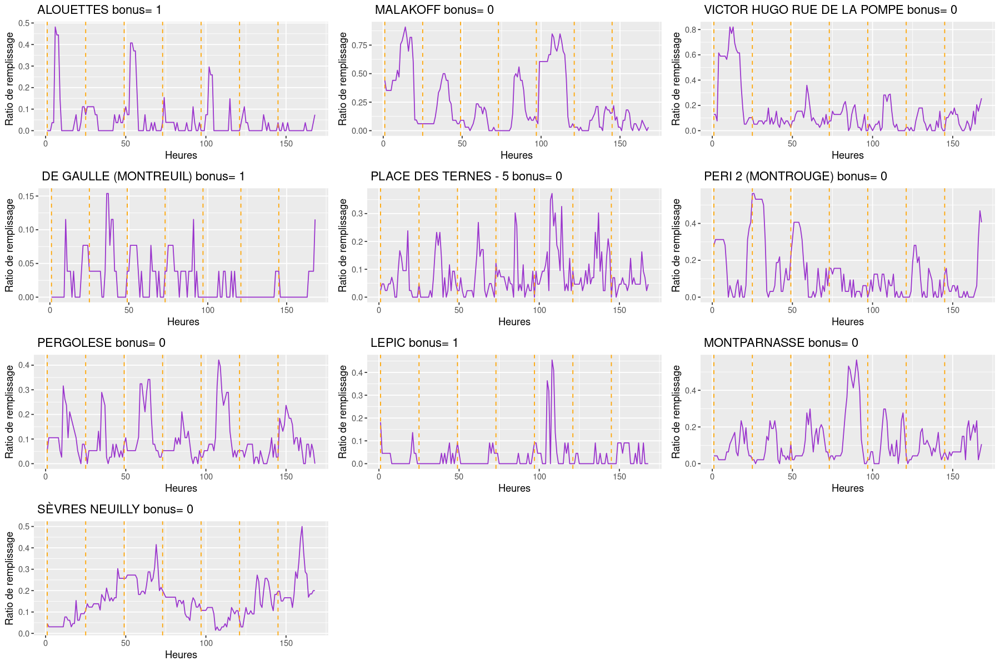

In [181]:
Cluster_1=which(reskmeans_pca$cluster==1)
Cluster_1=as.matrix(Cluster_1)
options(repr.plot.width = 15, repr.plot.height = 10)

timeTick = 1 + 24*(0:6)  #  vecteur délimitant les jours

# selection de 4 stations
stations = sample(Cluster_1, 10)
df = melt(loading[stations,])

p = list()
for (i in 1:10){
    dfi = df[df$Var1 == velib$names[stations[i]],]
    p[[i]] = ggplot(dfi, aes(x=Var2, y=value)) + 
    
        geom_line(col="darkorchid") + 
        geom_vline(xintercept=timeTick, col="orange", linetype="dashed") +
        labs(title=paste(velib$names[stations[i]],"bonus=",coord$bonus[stations[i]]), x="Heures", y="Ratio de remplissage")
}
do.call(grid.arrange,p)


Le cluster 1 représente les stations les moins remplies.

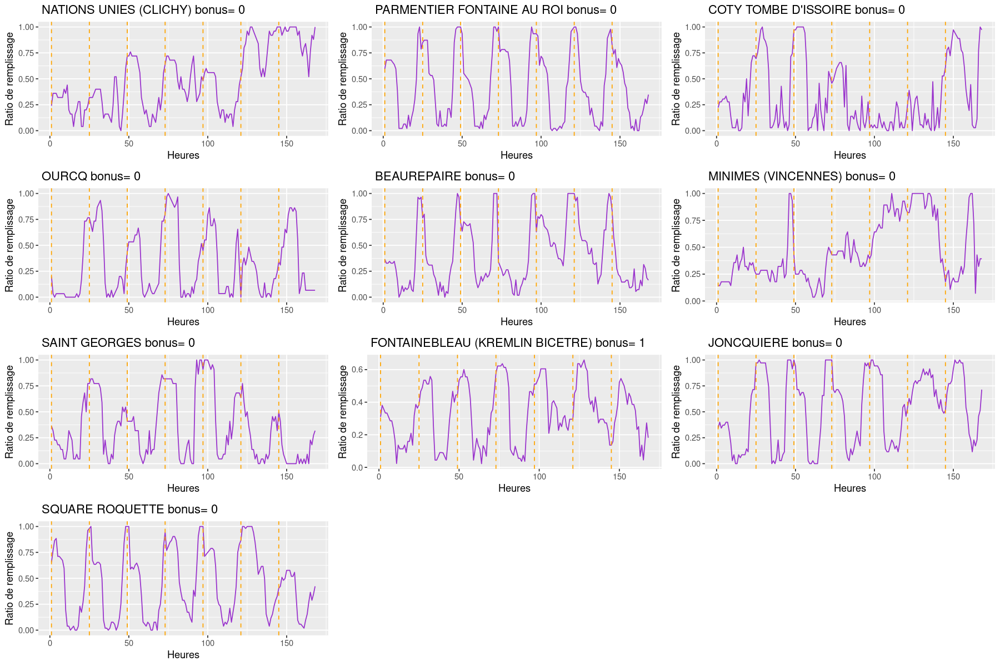

In [182]:
Cluster_2=which(reskmeans_pca$cluster==2)
Cluster_2=as.matrix(Cluster_2)
options(repr.plot.width = 15, repr.plot.height = 10)

timeTick = 1 + 24*(0:6)  #  vecteur délimitant les jours

# selection de 4 stations
stations = sample(Cluster_2, 10)
df = melt(loading[stations,])

p = list()
for (i in 1:10){
    dfi = df[df$Var1 == velib$names[stations[i]],]
    p[[i]] = ggplot(dfi, aes(x=Var2, y=value)) + 
    
        geom_line(col="darkorchid") + 
        geom_vline(xintercept=timeTick, col="orange", linetype="dashed") +
        labs(title=paste(velib$names[stations[i]],"bonus=",coord$bonus[stations[i]]), x="Heures", y="Ratio de remplissage")
}
do.call(grid.arrange,p)

Le cluster 2 représente les stations vides la journée et remplies la nuit.

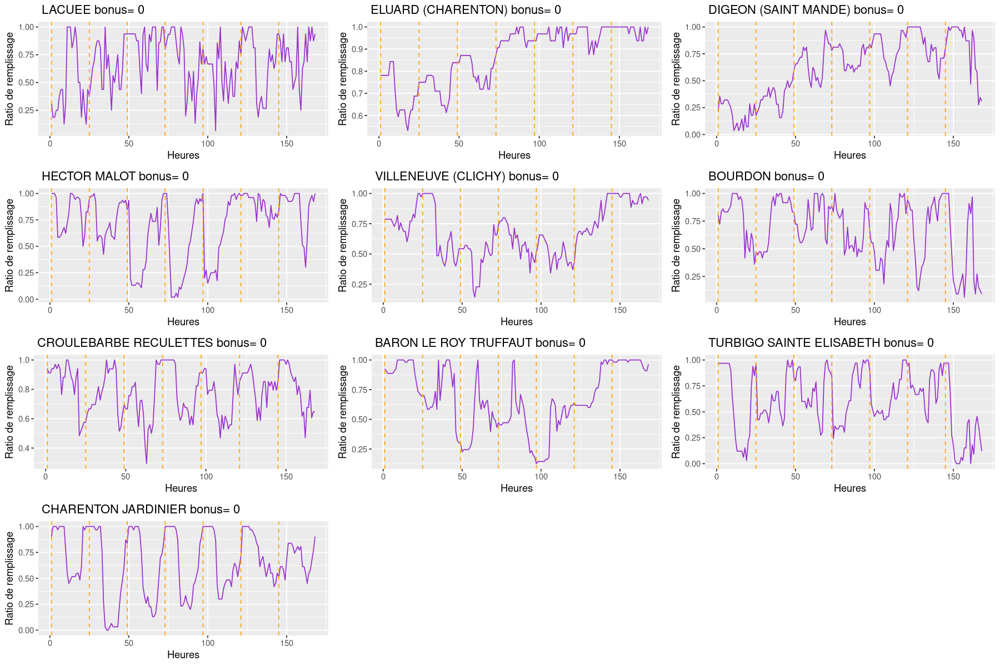

In [183]:
Cluster_3=which(reskmeans_pca$cluster==3)
Cluster_3=as.matrix(Cluster_3)
options(repr.plot.width = 15, repr.plot.height = 10)

timeTick = 1 + 24*(0:6)  #  vecteur délimitant les jours

# selection de 4 stations
stations = sample(Cluster_3, 10)
df = melt(loading[stations,])

p = list()
for (i in 1:10){
    dfi = df[df$Var1 == velib$names[stations[i]],]
    p[[i]] = ggplot(dfi, aes(x=Var2, y=value)) + 
    
        geom_line(col="darkorchid") + 
        geom_vline(xintercept=timeTick, col="orange", linetype="dashed") +
        labs(title=paste(velib$names[stations[i]],"bonus=",coord$bonus[stations[i]]), x="Heures", y="Ratio de remplissage")
}
do.call(grid.arrange,p)

Les stations du cluster 3 sont les stations plus remplies que la moyenne.

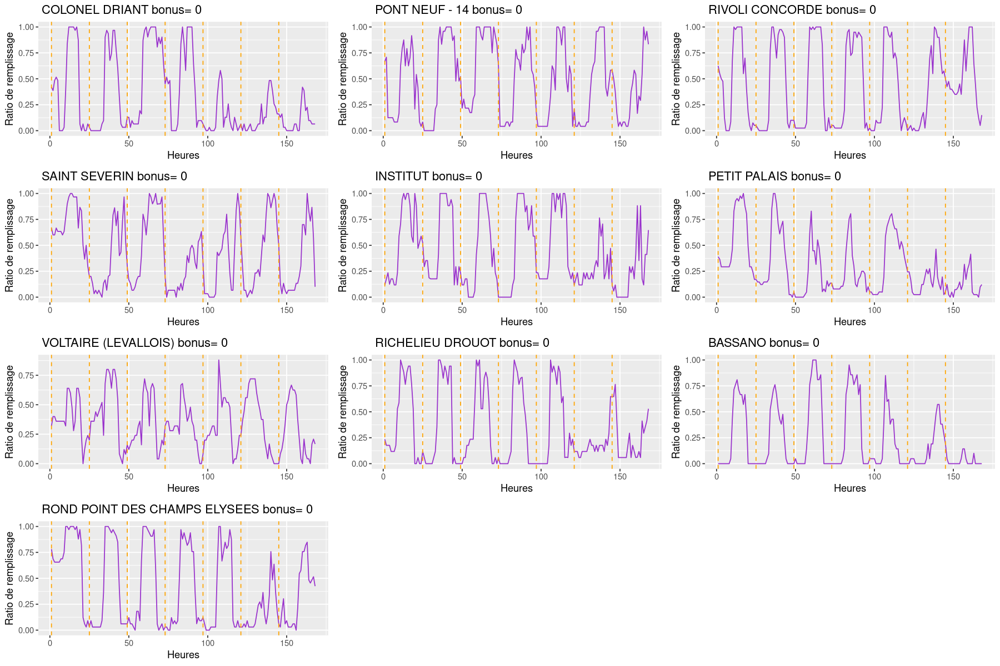

In [184]:
Cluster_4=which(reskmeans_pca$cluster==4)
Cluster_4=as.matrix(Cluster_4)
options(repr.plot.width = 15, repr.plot.height = 10)

timeTick = 1 + 24*(0:6)  #  vecteur délimitant les jours

# selection de 4 stations
stations = sample(Cluster_4, 10)
df = melt(loading[stations,])

p = list()
for (i in 1:10){
    dfi = df[df$Var1 == velib$names[stations[i]],]
    p[[i]] = ggplot(dfi, aes(x=Var2, y=value)) + 
    
        geom_line(col="darkorchid") + 
        geom_vline(xintercept=timeTick, col="orange", linetype="dashed") +
        labs(title=paste(velib$names[stations[i]],"bonus=",coord$bonus[stations[i]]), x="Heures", y="Ratio de remplissage")
}
do.call(grid.arrange,p)

Le cluster 4 regroupe les stations remplies la journée et vides la nuit.

### Classification ascendante hiérachique (CAH)

CAH est une méthode de clustering basée sur la distance entre les individus du jeu de données. L'un des principaux avantages de cet algorithme, est qu'il fournit une structure hiérachique qui permet une meilleure interprétation des relations entre les clusters. Elle permet aussi de pouvoir retrouver une séparation non linéaire entre les clusters. 

Nous choisissons d'utiliser la liaison Ward car elle nous permet de choisir à chaque étape le regroupement  qui implique la croissance minimale de l'inertie intraclasse. Les clusters formés ont l'avantage d'être compacts et homogènes.

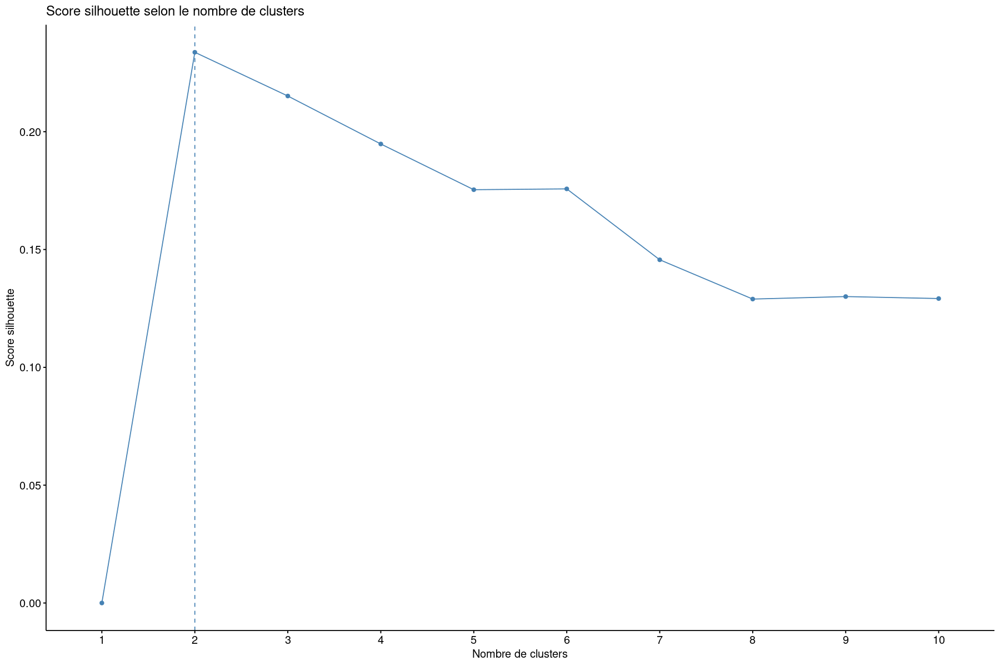

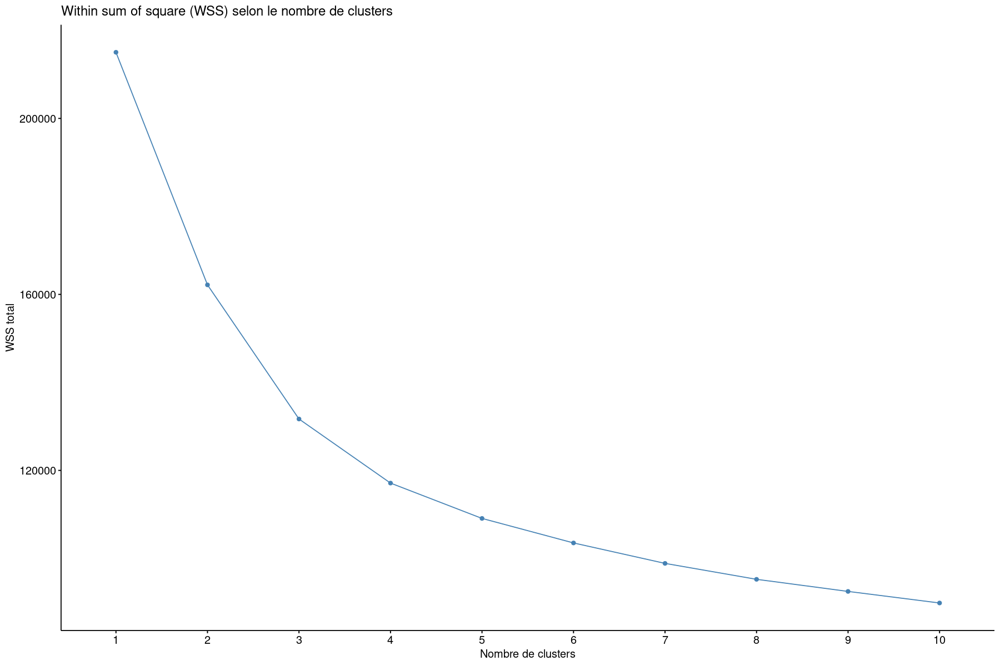

In [187]:
# on centre et on réduit
loading_scaled2=as.matrix(velib$data)
loading_scaled2 = scale(loading_scaled2, scale=T, center=T) 

# on choisit le nombre de clusters
fviz_nbclust(loading_scaled2,FUNcluster=hcut,method="silhouette")+
    ggtitle("Score silhouette selon le nombre de clusters")+
    labs(x="Nombre de clusters", y= "Score silhouette")
fviz_nbclust(loading_scaled2, FUNcluster=hcut, method="wss") +
    ggtitle("Within sum of square (WSS) selon le nombre de clusters")+
    labs(x="Nombre de clusters", y= "WSS total")

Nous pouvons donc choisir de prendre 2, 4 ou 6 clusters pour faire la classification.

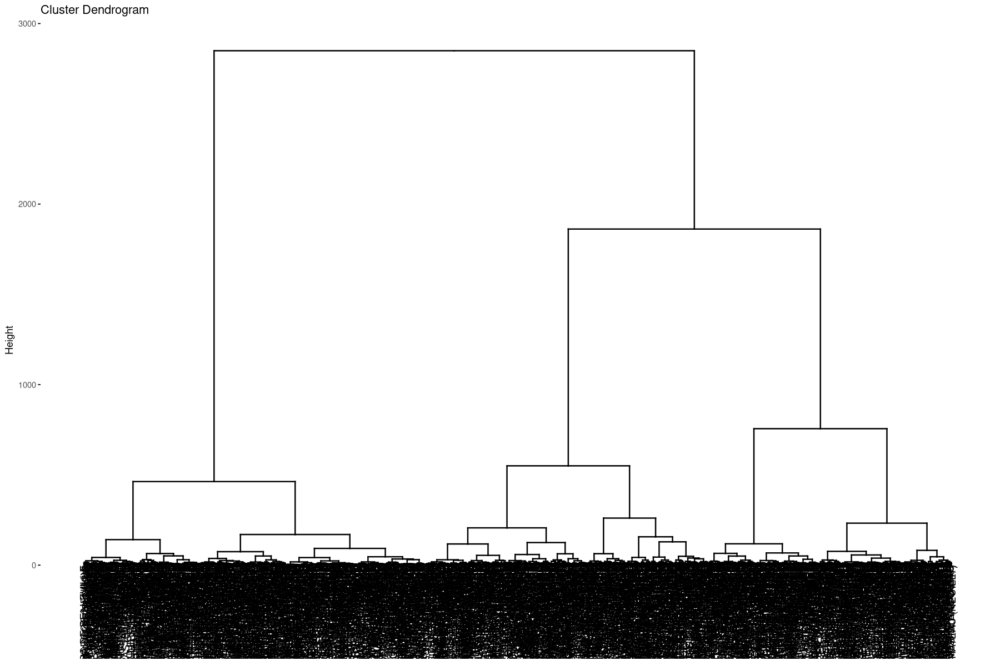

In [188]:
# implémentation de CAH : affichage de l'arbre
d=dist(loading_scaled,method="euclidian")

hclustward = hclust(d,method="ward.D")

fviz_dend(hclustward)

On obtient une arborescence assez équilibrée. On remarque que les regroupements dans le dendogramme se font assez tôt. On peut donc dire qu'il y a une grande similarité entre les individus d'un meme cluster. Il y a un  saut significatif à l'étape k=6. On choisit de couper l'arbre à ce niveau.

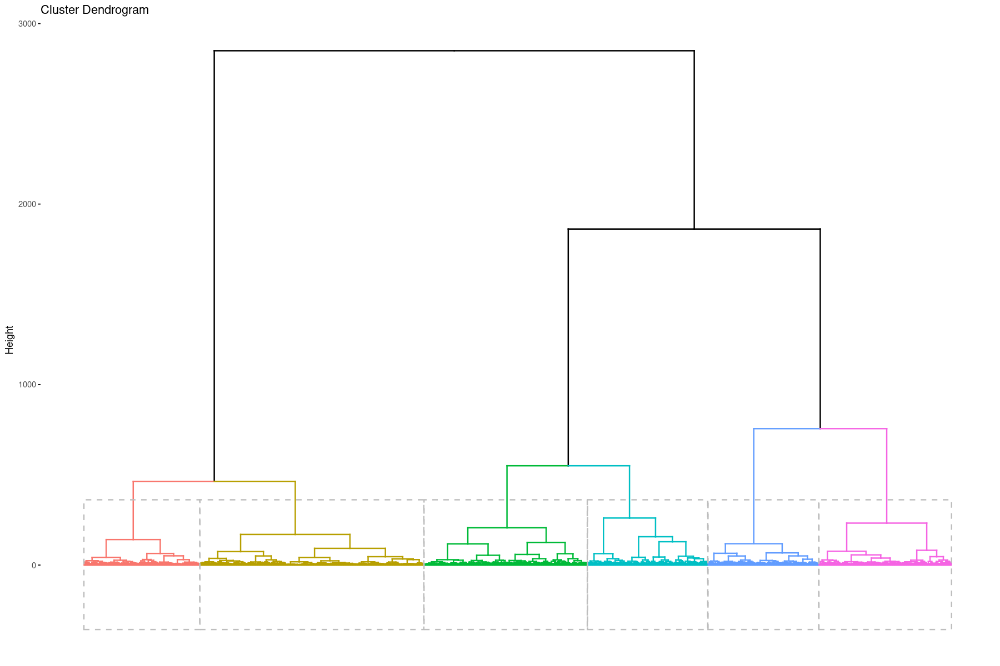

In [189]:
# affichage pour 6 clusters
reshclust = cutree(hclustward, 6)
fviz_dend(hclustward, k=6, show_labels=FALSE, rect=TRUE)

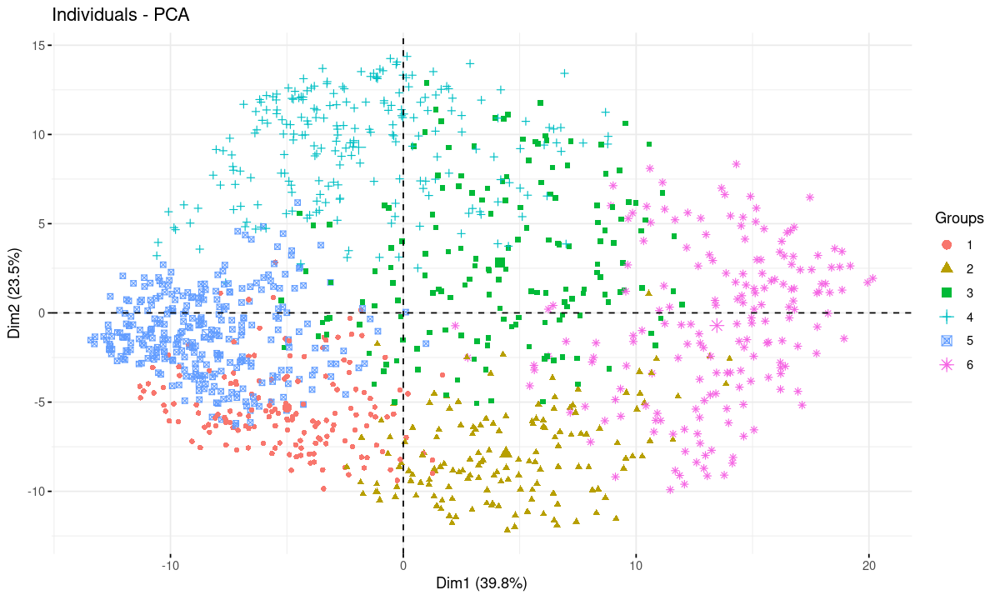

In [45]:
# on affiche le graph des individus
options(repr.plot.width = 10, repr.plot.height = 6)
fviz_pca_ind(pca, axes=c(1,2), geom=c("point"), habillage=as.factor(reshclust))

On obtient des classes assez séparées dans l'espace d'ACP. Même si tous les individus n'ont pas le même classement qu'avec la méthode k-means, la position des classes dans l'espace montre que leur signification est semblable à celles obtenues avec K-means. Nous allons cependant analyser les classes pour vérifier cette hypothèse.

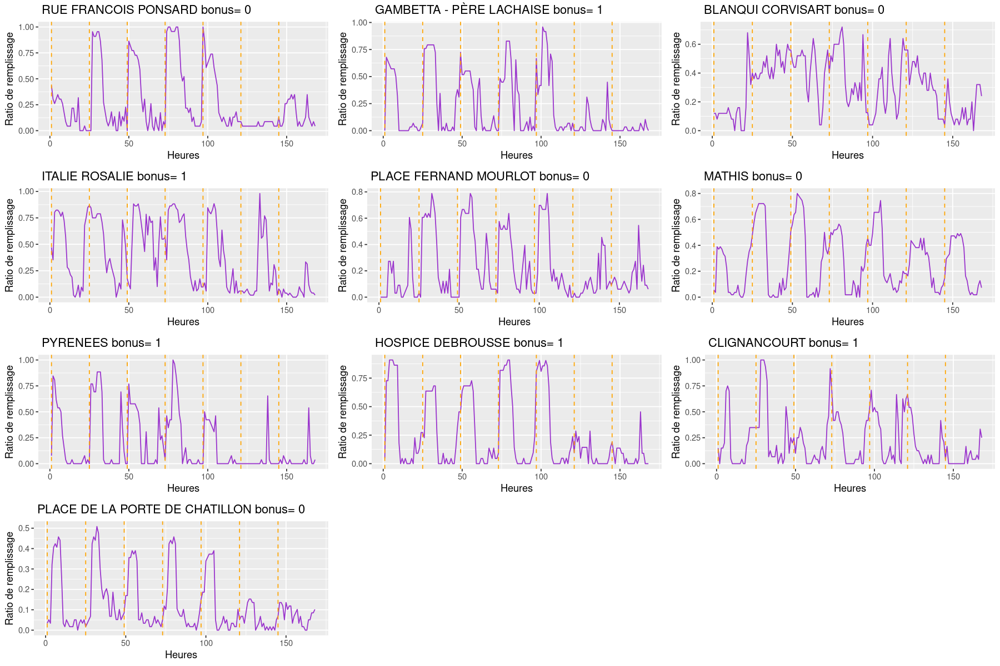

In [191]:
Cluster_1=which(reshclust==1)
Cluster_1=as.matrix(Cluster_1)
options(repr.plot.width = 15, repr.plot.height = 10)

timeTick = 1 + 24*(0:6)  #  vecteur délimitant les jours

# selection de 4 stations
stations = sample(Cluster_1, 10)
df = melt(loading[stations,])

p = list()
for (i in 1:10){
    dfi = df[df$Var1 == velib$names[stations[i]],]
    p[[i]] = ggplot(dfi, aes(x=Var2, y=value)) + 
    
        geom_line(col="darkorchid") + 
        geom_vline(xintercept=timeTick, col="orange", linetype="dashed") +
        labs(title=paste(velib$names[stations[i]],"bonus=",coord$bonus[stations[i]]), x="Heures", y="Ratio de remplissage")
}
do.call(grid.arrange,p)

Ce cluster semble représenter les stations dont le comportement varie entre les jours ouvrés et le weekend. Elles sont moins remplies le weekend en moyenne.

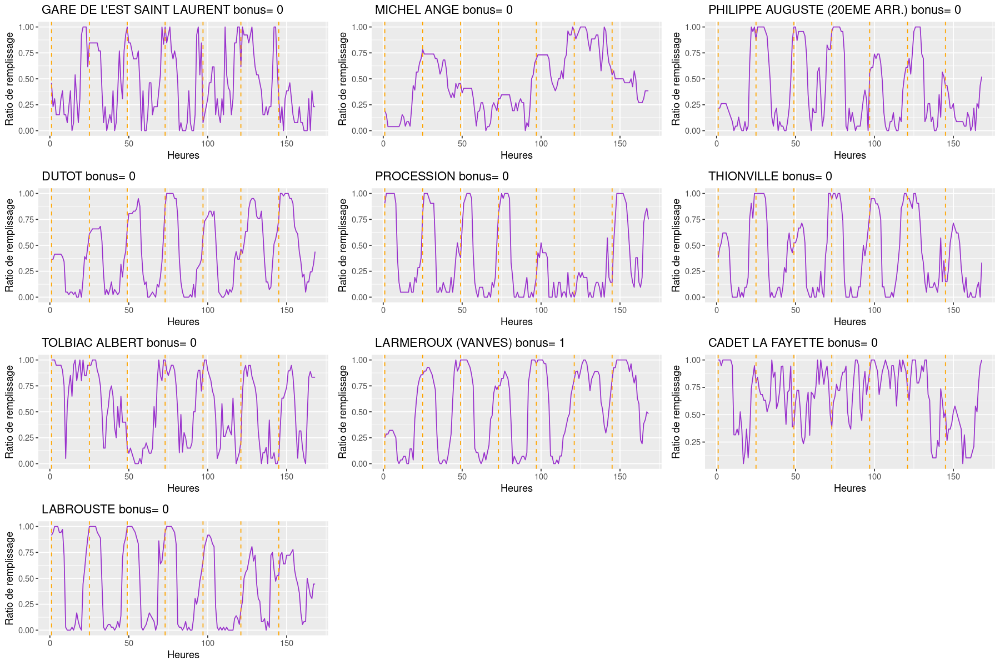

In [192]:
Cluster_2=which(reshclust==2)
Cluster_2=as.matrix(Cluster_2)
options(repr.plot.width = 15, repr.plot.height = 10)

timeTick = 1 + 24*(0:6)  #  vecteur délimitant les jours

# selection de 4 stations
stations = sample(Cluster_2, 10)
df = melt(loading[stations,])

p = list()
for (i in 1:10){
    dfi = df[df$Var1 == velib$names[stations[i]],]
    p[[i]] = ggplot(dfi, aes(x=Var2, y=value)) + 
    
        geom_line(col="darkorchid") + 
        geom_vline(xintercept=timeTick, col="orange", linetype="dashed") +
        labs(title=paste(velib$names[stations[i]],"bonus=",coord$bonus[stations[i]]), x="Heures", y="Ratio de remplissage")
}
do.call(grid.arrange,p)

Le cluster 2 regroupe les stations vides la journée et remplies dans la soirée.

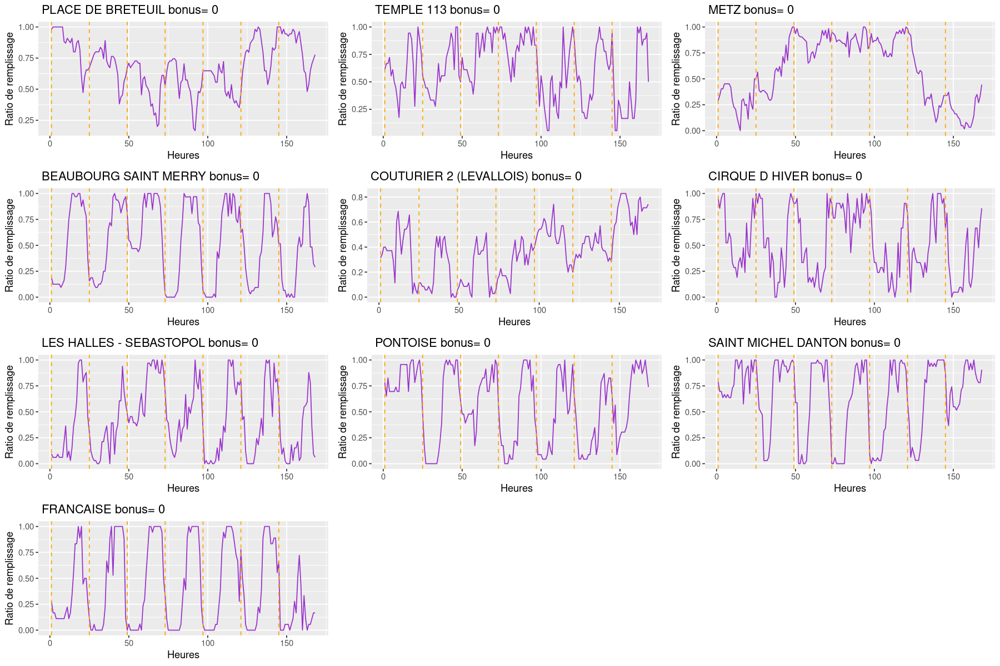

In [194]:
Cluster_3=which(reshclust==3)
Cluster_3=as.matrix(Cluster_3)
options(repr.plot.width = 15, repr.plot.height = 10)

timeTick = 1 + 24*(0:6)  #  vecteur délimitant les jours

# selection de 4 stations
stations = sample(Cluster_3, 10)
df = melt(loading[stations,])

p = list()
for (i in 1:10){
    dfi = df[df$Var1 == velib$names[stations[i]],]
    p[[i]] = ggplot(dfi, aes(x=Var2, y=value)) + 
    
        geom_line(col="darkorchid") + 
        geom_vline(xintercept=timeTick, col="orange", linetype="dashed") +
        labs(title=paste(velib$names[stations[i]],"bonus=",coord$bonus[stations[i]]), x="Heures", y="Ratio de remplissage")
}
do.call(grid.arrange,p)

remplies la journée

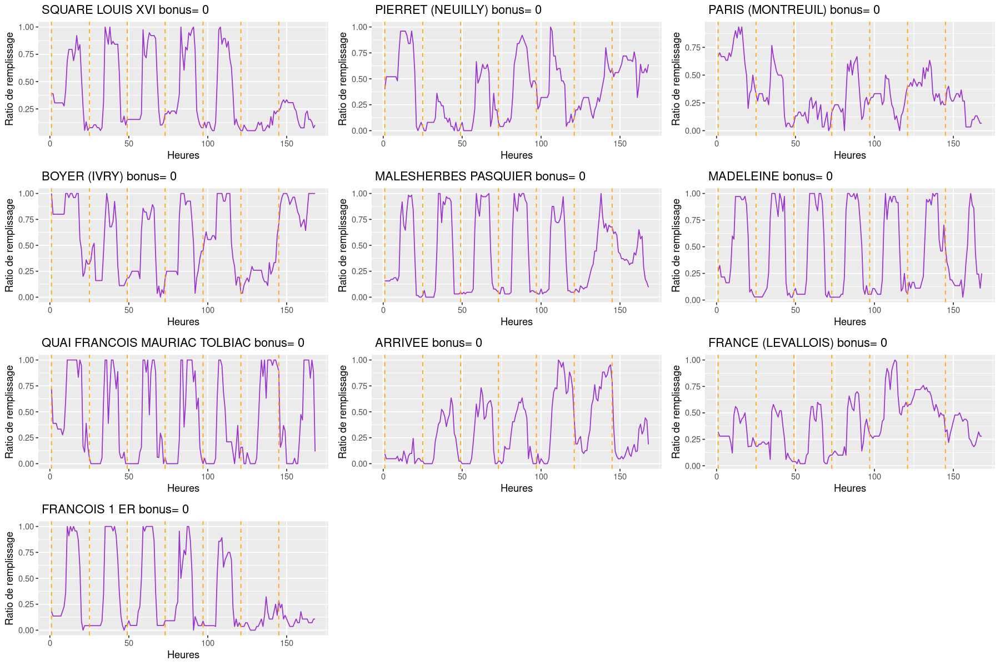

In [195]:
Cluster_4=which(reshclust==4)
Cluster_4=as.matrix(Cluster_4)
options(repr.plot.width = 15, repr.plot.height = 10)

timeTick = 1 + 24*(0:6)  #  vecteur délimitant les jours

# selection de 4 stations
stations = sample(Cluster_4, 10)
df = melt(loading[stations,])

p = list()
for (i in 1:10){
    dfi = df[df$Var1 == velib$names[stations[i]],]
    p[[i]] = ggplot(dfi, aes(x=Var2, y=value)) + 
    
        geom_line(col="darkorchid") + 
        geom_vline(xintercept=timeTick, col="orange", linetype="dashed") +
        labs(title=paste(velib$names[stations[i]],"bonus=",coord$bonus[stations[i]]), x="Heures", y="Ratio de remplissage")
}
do.call(grid.arrange,p)

horaires de travail (journée + pas le weekend)

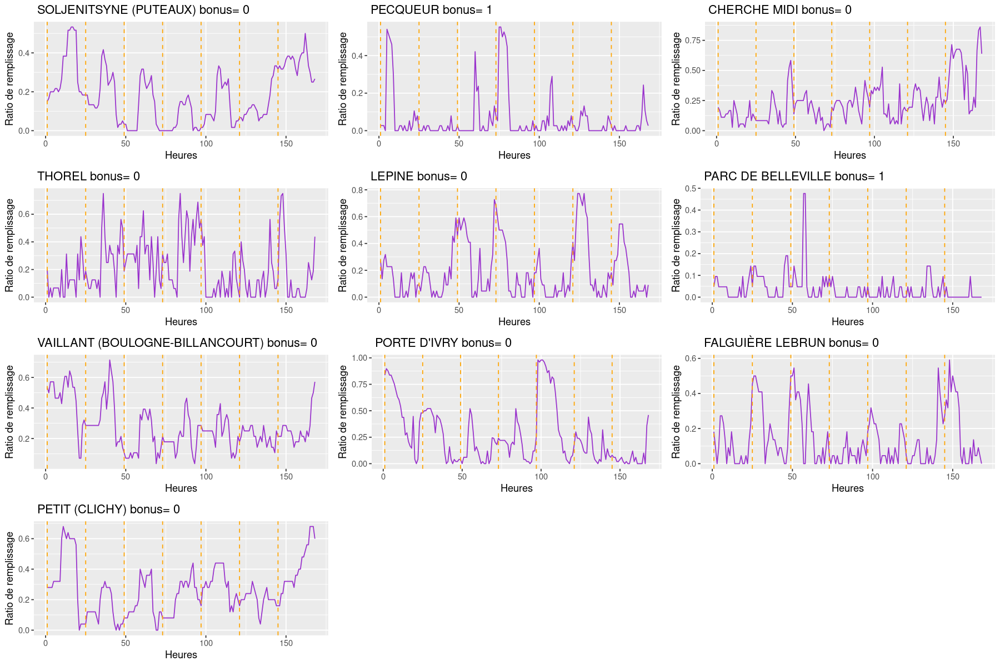

In [197]:
Cluster_5=which(reshclust==5)
Cluster_5=as.matrix(Cluster_5)
options(repr.plot.width = 15, repr.plot.height = 10)

timeTick = 1 + 24*(0:6)  #  vecteur délimitant les jours

# selection de 4 stations
stations = sample(Cluster_5, 10)
df = melt(loading[stations,])

p = list()
for (i in 1:10){
    dfi = df[df$Var1 == velib$names[stations[i]],]
    p[[i]] = ggplot(dfi, aes(x=Var2, y=value)) + 
    
        geom_line(col="darkorchid") + 
        geom_vline(xintercept=timeTick, col="orange", linetype="dashed") +
        labs(title=paste(velib$names[stations[i]],"bonus=",coord$bonus[stations[i]]), x="Heures", y="Ratio de remplissage")
}
do.call(grid.arrange,p)

moins remplies

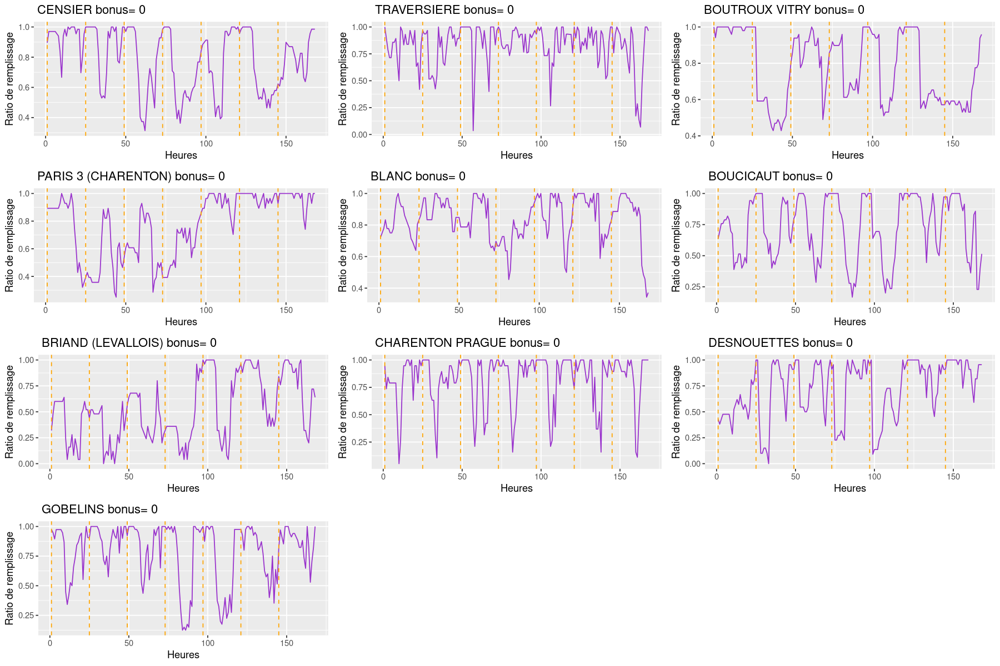

In [198]:
Cluster_6=which(reshclust==6)
Cluster_6=as.matrix(Cluster_6)
options(repr.plot.width = 15, repr.plot.height = 10)

timeTick = 1 + 24*(0:6)  #  vecteur délimitant les jours

# selection de 4 stations
stations = sample(Cluster_6, 10)
df = melt(loading[stations,])

p = list()
for (i in 1:10){
    dfi = df[df$Var1 == velib$names[stations[i]],]
    p[[i]] = ggplot(dfi, aes(x=Var2, y=value)) + 
    
        geom_line(col="darkorchid") + 
        geom_vline(xintercept=timeTick, col="orange", linetype="dashed") +
        labs(title=paste(velib$names[stations[i]],"bonus=",coord$bonus[stations[i]]), x="Heures", y="Ratio de remplissage")
}
do.call(grid.arrange,p)

plus remplies

### Gaussian Mixture Models (GMM)

Gaussian Mixture Models (GMM) est un algorithme de classification basé sur le fait que le jeu de données total est composé de plusieurs sous-groupes indépendants. Les individus au sein du même groupe sont distribués selon la même loi. 
Afin de sélectionner le bon modèle, nous allons minimiser le critère BIC ou le critère ICL.

In [46]:
# on installe les packages nécessaires
install.packages('mclust')
library(mclust)

Installation du package dans ‘/home/hountong/R/libs’
(car ‘lib’ n'est pas spécifié)

Warning message in install.packages("mclust"):
“l'installation du package ‘mclust’ a eu un statut de sortie non nul”
Package 'mclust' version 6.1
Type 'citation("mclust")' for citing this R package in publications.



---------------------------------------------------- 
Gaussian finite mixture model fitted by EM algorithm 
---------------------------------------------------- 

Mclust VVE (ellipsoidal, equal orientation) model with 7 components: 

 log-likelihood    n df       BIC       ICL
      -15350.94 1189 86 -31310.83 -31620.33

Clustering table:
  1   2   3   4   5   6   7 
213 138 174 271 102 141 150 

Warning message:
“`gather_()` was deprecated in tidyr 1.2.0.
ℹ Please use `gather()` instead.
ℹ The deprecated feature was likely used in the factoextra package.
  Please report the issue at <https://github.com/kassambara/factoextra/issues>.”


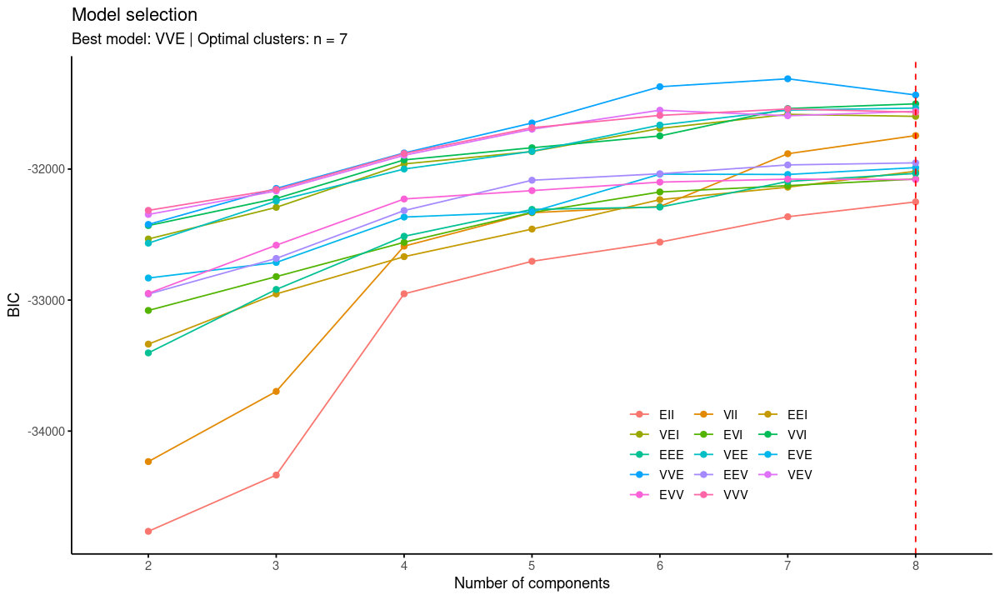

In [47]:
# on cherche le nombre de clusters
resBICall = Mclust(loading_reduced, G=2:8)
summary(resBICall)

fviz_mclust(resBICall, what="BIC")

In [48]:
# on récupère le critère ICL
resICLall = mclustICL(loading_reduced, G=2:8)
summary(resICLall)

Best ICL values:
             VVE,7        VVE,6       VVE,8
ICL      -31620.33 -31648.34233 -31804.7723
ICL diff      0.00    -28.01348   -184.4435

Ces deux critères mènent à la même conclusion: Le nombre de clusters optimal est 7 et les clusters seront elliptiques de volumes différents et d'orientations différentes.

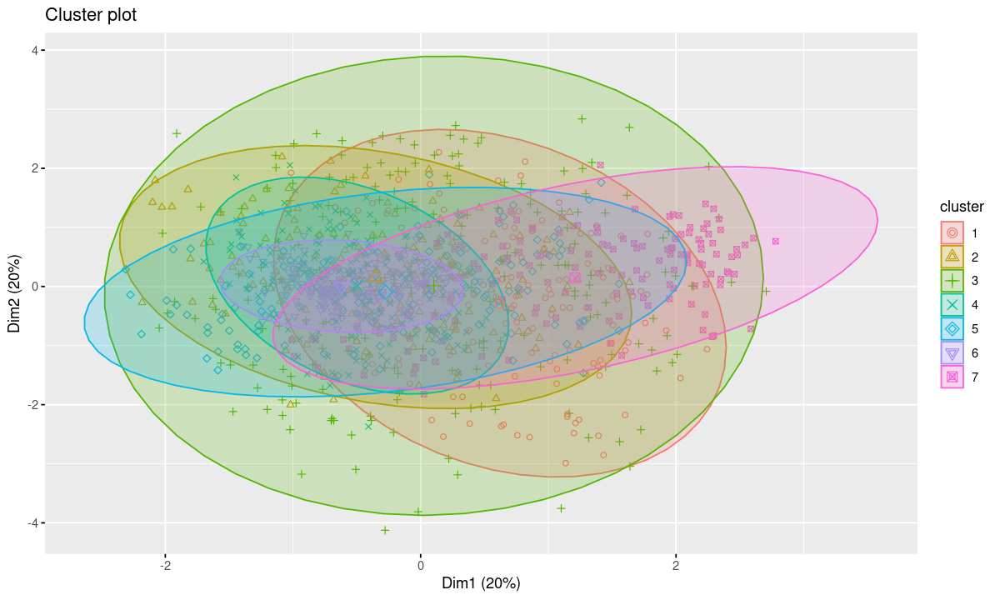

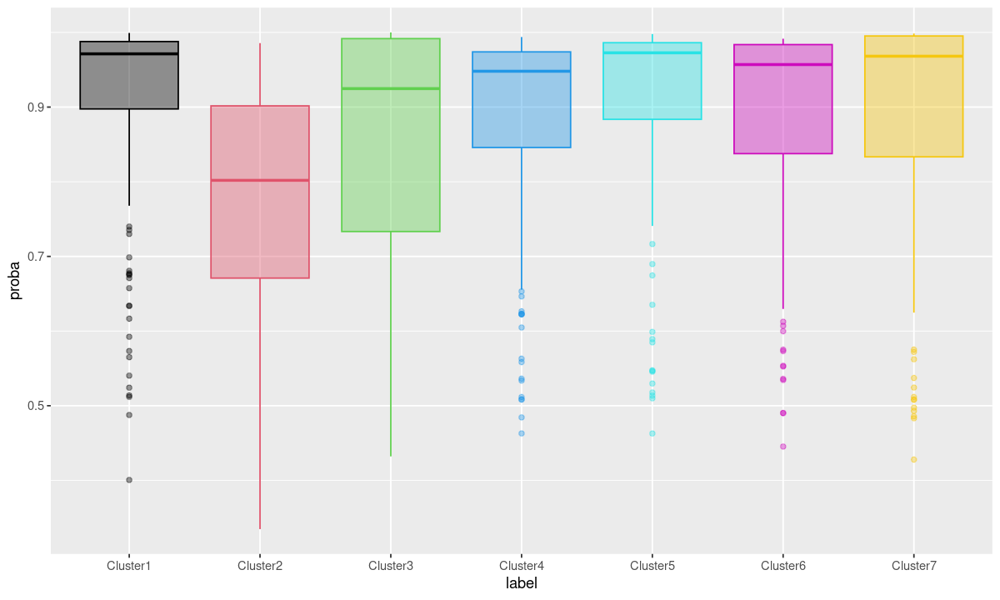

In [49]:
# on centre et on réduit les données réduites
loading_scaled=as.matrix(velib$data)
loading_scaled = scale(loading_scaled, scale=T, center=T)
pca_result=prcomp(loading_scaled)
loading_pca <- predict(pca_result)
loading_reduced2=loading_pca[,1:5]

# on implémente la méthode GMM avec les données trouvées plus haut
resGMM = Mclust(loading_reduced2, G=7, modelNames = "VVE")

# affichage des clusters et du boxplot
fviz_cluster(resGMM, data=loading_reduced2, ellipse.type="norm", geom="point")

aux = data.frame(
    label = paste("Cluster", resGMM$classification, sep=""), 
    proba = apply(resGMM$z, 1, max))

ggplot(aux, aes(x=label, y=proba)) + 
    geom_boxplot(colour=1:7, fill=1:7, alpha=.4)

Du boxplot, on voit que la probabilité d'appartenance de chaque individu à la classe attribuée est assez forte en général. L'algorithme fait donc une bonne classification.

## IV- Comparaison des différentes classifications

### Utilisation des données avec ou sans traitement d'ACP

In [50]:
library(cvms)


Attachement du package : ‘cvms’


L'objet suivant est masqué depuis ‘package:ggpubr’:

    font




In [51]:
table('K-means ACP'=reskmeans_pca$cluster, 'K-meanS sans ACP'=reskmeans3$cluster)

conf_mat = confusion_matrix(targets=reskmeans_pca$cluster, predictions=reskmeans3$cluster )
#plot_confusion_matrix(conf_mat)

           K-meanS sans ACP
K-means ACP   1   2   3   4   5   6
          1   7   0   0 275  15   0
          2   0   0  72 109  37   0
          3   0   0 120   0  18  48
          4 168  13   0   0   9   0
          5   0 103   0   0  34  12
          6   0   0   0   0   0 149

Afin de mieux visualiser la différence entre les deux méthodes, nous allons réordonner les classes afin que les indices correspondent entre eux.

In [52]:
matchClasses <- function(classif1, classif2) {
cm <- table(classif1, classif2)
K <- nrow(cm)
a <- integer(K)
b <- integer(K)
for (j in 1:K) {
for (i in 1:K) {
if (a[j] < cm[i, j]) {
a[j] <- cm[i, j]
b[j] <- i}}}
table <- cm
for (i in 1:K) {
table[, b[i]] <- cm[, i]
}
clusters <- classif2
n <- length(classif2)
for (i in 1:n) {
for (j in 1:K) {
if (classif2[i] == j) {
clusters[i] <- b[j]}}}
return(list(table = table, clusters = clusters))
}

In [53]:
result <- matchClasses(reskmeans_pca$cluster, reskmeans3$cluster)
print("Table de confusion réordonnée:")
print(result$table)
new_cluster_labels<- result$clusters

conf_mat_reordered <- confusion_matrix(targets =reskmeans_pca$cluster, predictions =new_cluster_labels)
#plot_confusion_matrix(conf_mat_reordered)

[1] "Table de confusion réordonnée:"
        classif2
classif1   1   2   3   4   5   6
       1 275  15   0   7   0   0
       2 109  37  72   0   0   0
       3   0  18 120   0   0  48
       4   0   9   0 168  13   0
       5   0  34   0   0 103  12
       6   0   0   0   0   0 149


Les deux classifications ont approximativement la même structure. La principale différence se situe dans la classe 2 des données avec ACP  qui regroupe trois clusters de k-means sans ACP.


Pour la comparaison des autres méthodes, nous allons faire une Analyse en Correspondance Multiple (MCA) à la place de plusieurs tables de contingence. 
Mais avant, nous allons réordonner les classifications avec le même nombre de clusters pour plus d'interprêtabilité.

In [54]:
# Reordonnons les classes de nos différents clusters
reskmeans3_cluster=new_cluster_labels

resultC <- matchClasses(reskmeans_pca$cluster, reshclust)
new_clusterC_labels<- resultC$clusters
reshclust=new_clusterC_labels

### Analyse en Correspondance Multiple (MCA)

Afin de visualiser les différences et les similitudes dans les clusterings réalisés par les différentes méthodes, nous allons faire une Analyse en Correspondance Multiple (MCA). Cette méthode va nous permettre de décrire les relations entre les classifications faites par les différentes méthodes. Comme l'ACP, la MCA permet de projeter les individus dans un espace de dimension réduit tout en préservant autant que possible l'information. 

#### MCA sur les clusters 

In [55]:
# nos variables sont les clusters définis plus haut
df_clusters= data.frame (
    km2c= reskmeans$cluster, 
    km4c=reskmeans2$cluster,
    km6c=reskmeans3_cluster,
    kmPCA6c= reskmeans_pca$cluster, 
    cahC= reshclust,
    gmmC= resGMM$classification,
    hill=coord$bonus#,
    #load_moyen=rowMeans(loading)#,
    #load_ouvrés=rowMeans(loading[,1:120]),
    #load_we=rowMeans(loading[,121:168]),
    #horaires_actifs=rowMeans(loading[,c(8:19,32:43,56:67,80:91,104:115)]),
    #horaires_repos=rowMeans(loading[,c(1:7,20:23,24:31,44:55,68:79,92:103,116:127)])
)    

In [56]:
# on transfome nos variables en factor
df_clusters[1:7]= lapply(df_clusters[1:7], factor)

In [57]:
str(df_clusters)

'data.frame':	1189 obs. of  7 variables:
 $ km2c   : Factor w/ 2 levels "1","2": 1 2 2 1 2 1 2 2 2 1 ...
 $ km4c   : Factor w/ 4 levels "1","2","3","4": 1 1 2 2 2 1 1 1 4 2 ...
 $ km6c   : Factor w/ 6 levels "1","2","3","4",..: 3 3 5 4 5 3 3 3 6 2 ...
 $ kmPCA6c: Factor w/ 6 levels "1","2","3","4",..: 2 3 5 4 5 2 3 3 6 2 ...
 $ cahC   : Factor w/ 6 levels "1","2","3","4",..: 2 3 5 4 5 3 3 3 5 5 ...
 $ gmmC   : Factor w/ 7 levels "1","2","3","4",..: 4 4 3 1 1 2 2 4 3 3 ...
 $ hill   : Factor w/ 2 levels "0","1": 1 1 1 1 1 1 1 1 1 1 ...


In [58]:
# on applique la MCA
res.mca = MCA(df_clusters[1:6], graph=FALSE)
#print(res.mca)

,eigenvalue,percentage of variance,cumulative percentage of variance
dim 1,0.8566531,20.559673,20.55967
dim 2,0.7249609,17.399061,37.95873
dim 3,0.6051457,14.523497,52.48223
dim 4,0.4435416,10.644999,63.12723
dim 5,0.3276077,7.862584,70.98982
dim 6,0.2581425,6.195419,77.18523


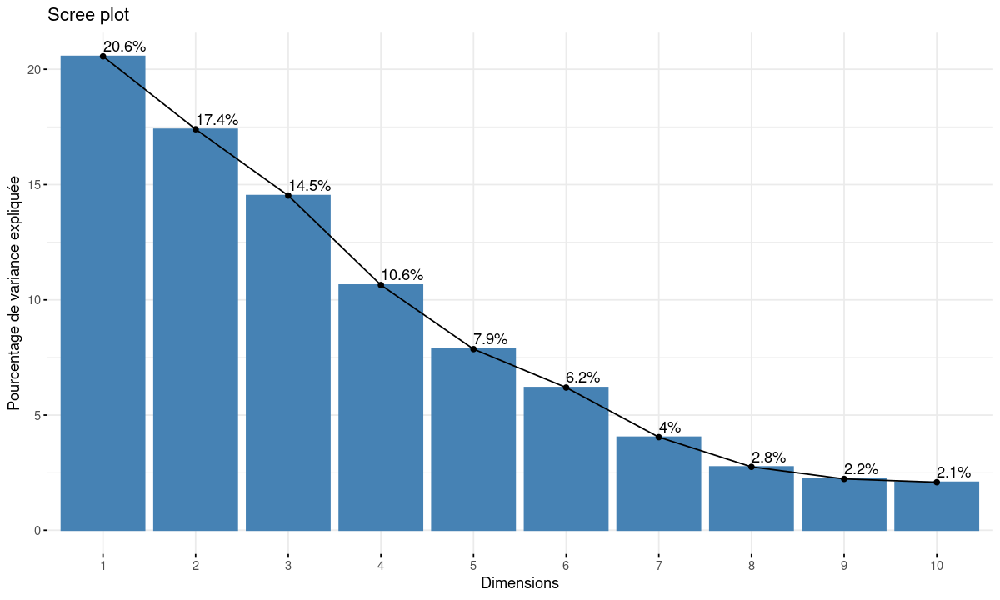

In [59]:
# on détermine le nombre de dimensions que l'on souhaite garder
head(res.mca$eig)

fviz_screeplot(res.mca, addlabels=TRUE, ylab="Pourcentage de variance expliquée")

Nous choisissons de garder les deux premiers axes pour expliquer environ 40% de l'inertie totale. 

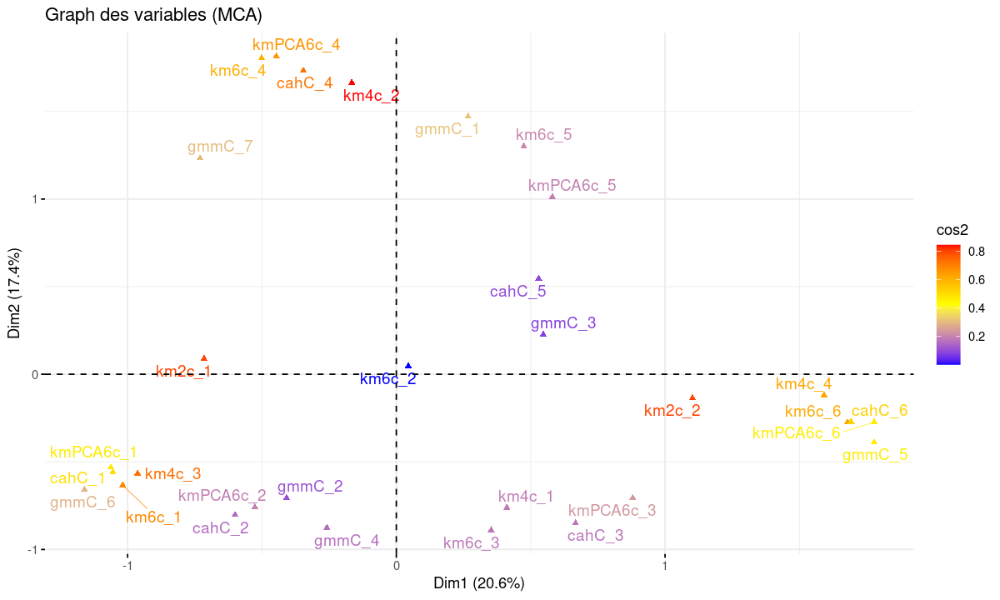

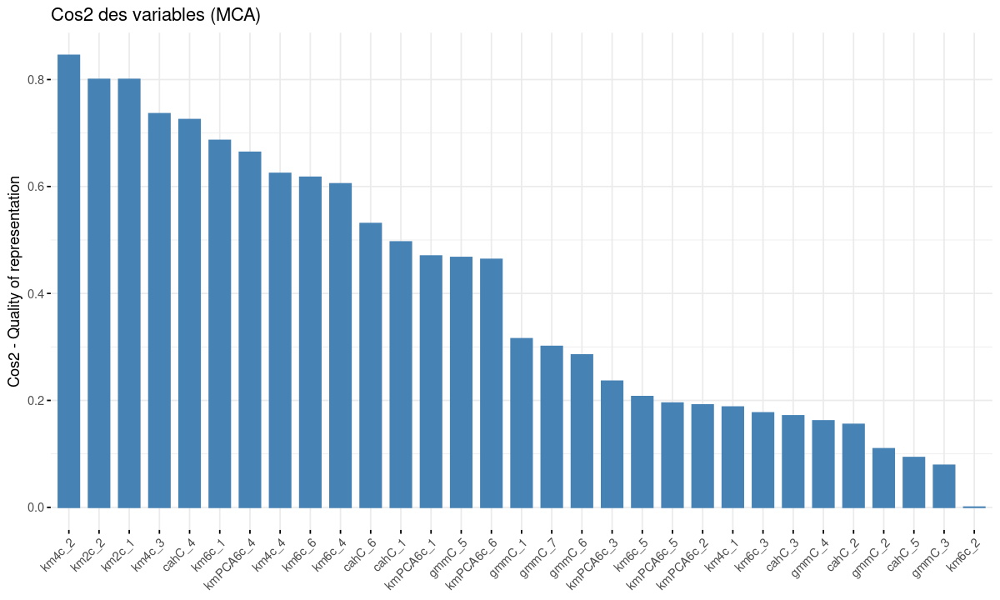

In [60]:
# graph des variables 
fviz_mca_var(res.mca, col.var = "cos2", title="Graph des variables (MCA)",
             gradient.cols = c("blue", "yellow", "red"), 
             repel = TRUE)


# Cos2 des variables sur Dim.1 et Dim.2
fviz_cos2(res.mca, choice = "var", axes = 1:2, title="Cos2 des variables (MCA)")

Le graphe des variables nous montre que la qualité de représentation des modalités n'est pas uniforme  dans le plan 1-2. Les modalités comme gmmC-2, cahC-5, gmmC-3 et Km6c_2 ne sont pas du tout bien représentées. 

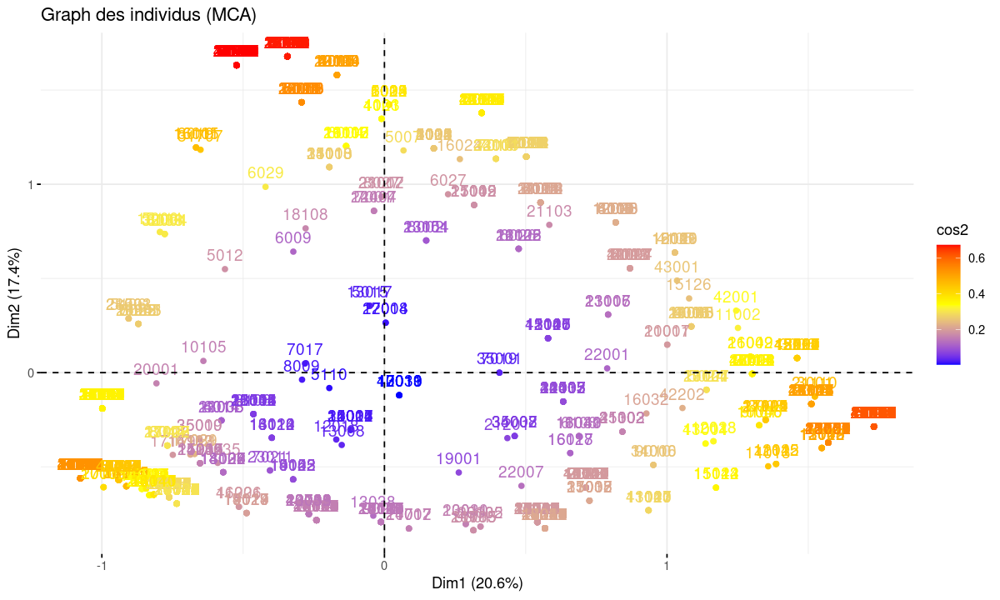

In [61]:
# graph des individus 
fviz_mca_ind(res.mca, col.ind = "cos2", title="Graph des individus (MCA)",
             gradient.cols = c("blue", "yellow", "red"))

On remarque également sur le graphe des individus que la qualité de représentation de ceux ci n'est pas uniforme. Il faudra donc se référer aux points dont la qualité de représentation est acceptable dans notre analyse. 


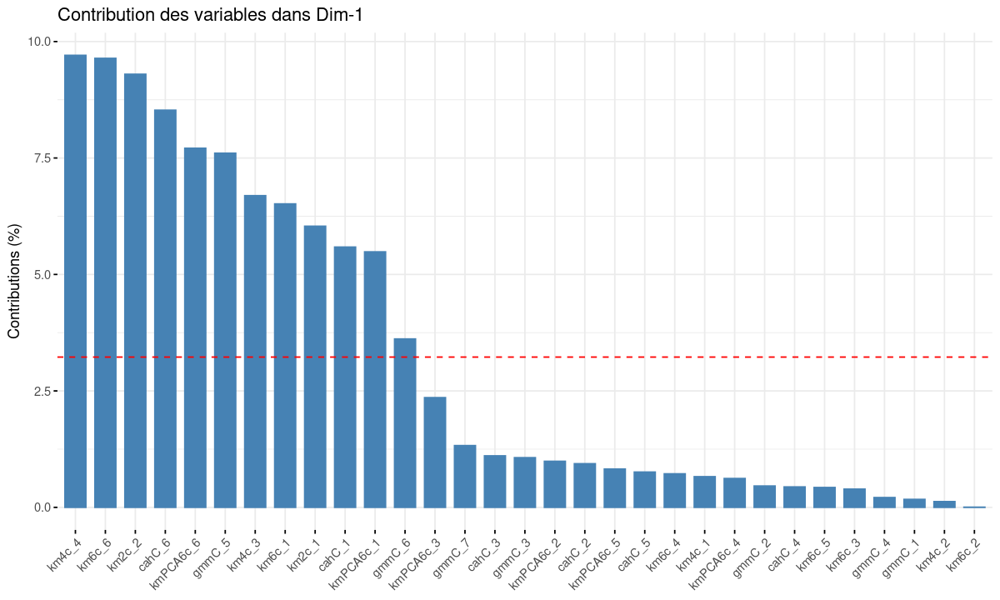

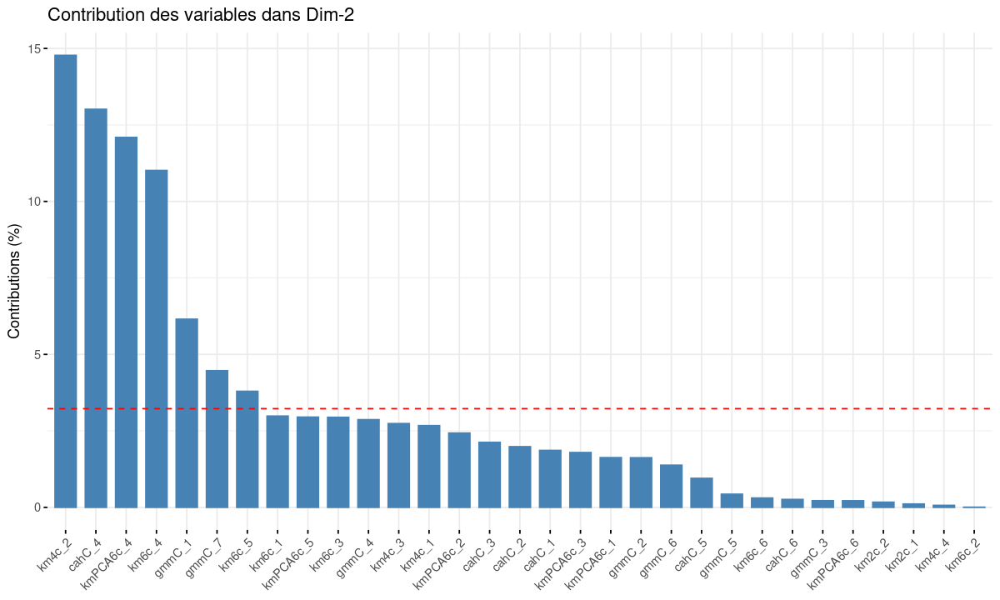

In [62]:
# graph pour la contribution des variables sur chaque dimension
fviz_contrib(res.mca, choice="var", axes=1, title="Contribution des variables dans Dim-1")

fviz_contrib(res.mca, choice="var", axes=2, title="Contribution des variables dans Dim-2")

Les modalités qui contribuent le plus à la première dimension sont celles qui sont relatives à la dernière classe de chaque variable.
La dimension 2 est quant à elle liée à km4c-2, cahC-4 et kmPCA6c-4.

Les axes dans l'espace de MCA sont difficilement interprétables. Nous n'arrivons pas à donner un sens aux différents axes.

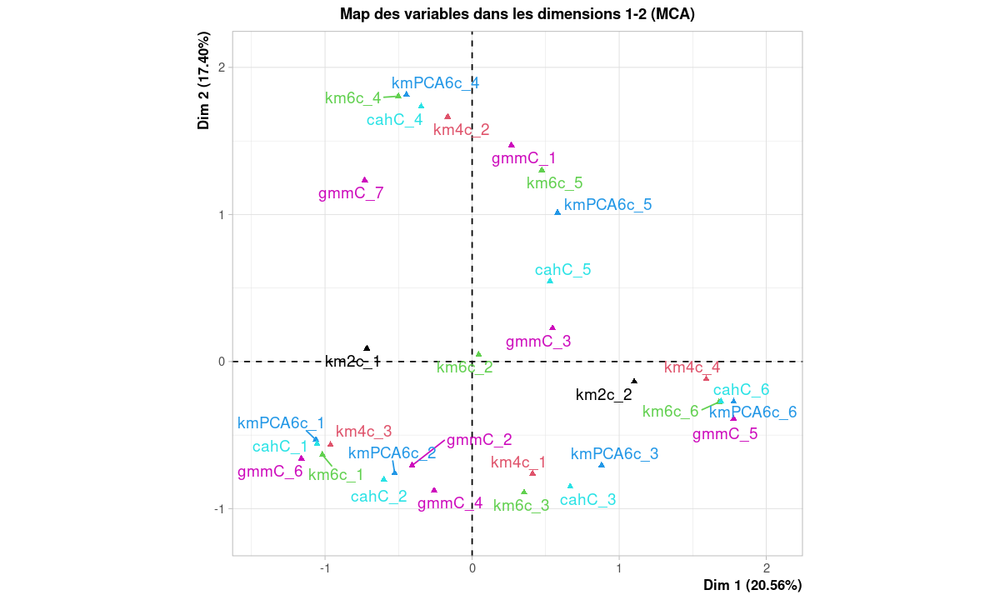

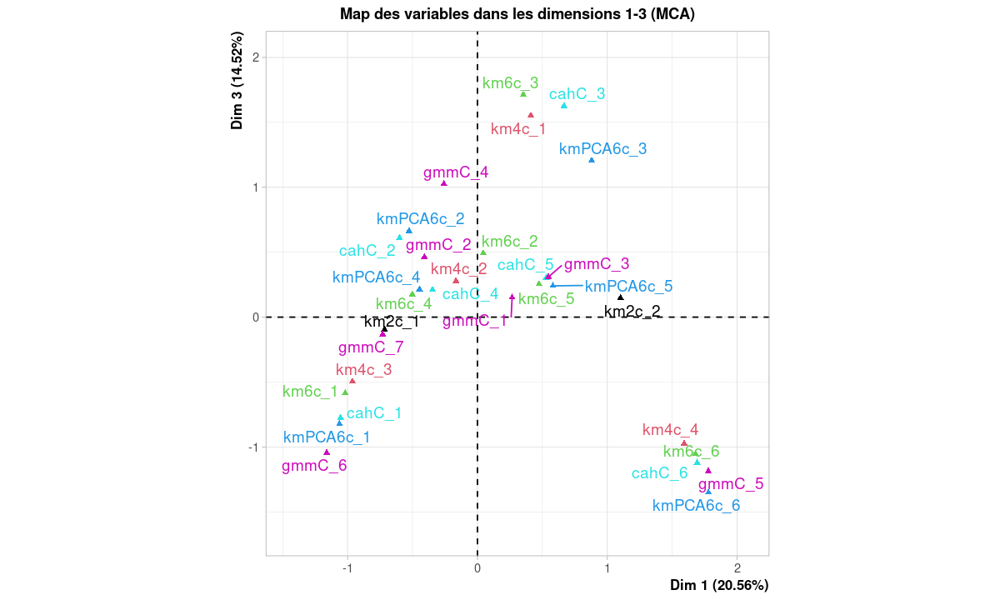

In [63]:
# graph des variables
plot(res.mca, invisible="ind", title="Map des variables dans les dimensions 1-2 (MCA)",
     hab = "quali",axes=c(1,2))

plot(res.mca, invisible="ind",title="Map des variables dans les dimensions 1-3 (MCA)",
     hab = "quali",axes=c(1,3))

Sur ces graphiques, on voit que les classes liées à chaque méthode sont assez éloignées les unes des autres dans l'espace de MCA. Nos classifications ont donc bien permis de maximiser l'inertie inter-classes. De plus, on remarque que les modalités liées à un même cluster sont regroupées. Les classes retrouvées par les différentes méthodes ont donc une similarité.

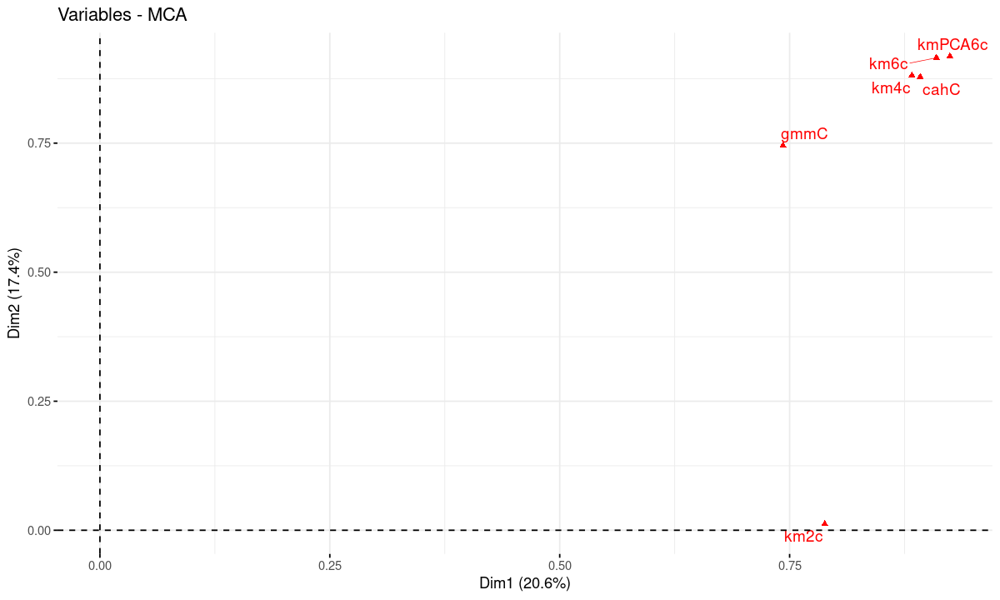

In [64]:
# Correlation avec les axes 
fviz_mca_var(res.mca,choice="mca.cor", repel=TRUE)

Le graphique des corrélations vient confirmer que les différentes classifications ne sont pas indépendantes; sauf la méthode k-means avec deux classes. On remarque cependant que la classification GMM  est moins liée aux autres méthodes.

Nous allons rajouter la variable Bonus dans notre espace de MCA afin de voir s'il y a une classe qui lui correspond. Nous allons également ajouter le chargement moyen, le chargement des horaires actifs et le chargement des horaires de repos des stations en tant que variables quantitatives supplémentaires.

In [65]:
res.mca = MCA(df_clusters, quali.sup=7,graph=FALSE)

In [66]:
library(tidyverse)
#library(ggpubr)


── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.0     ✔ readr     2.1.4
✔ forcats   1.0.0     ✔ stringr   1.5.0
✔ lubridate 1.9.3     ✔ tibble    3.2.1
✔ purrr     1.0.1     ✔ tidyr     1.3.0
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ purrr::%||%()    masks base::%||%()
✖ dplyr::combine() masks gridExtra::combine()
✖ dplyr::filter()  masks stats::filter()
✖ dplyr::lag()     masks stats::lag()
✖ purrr::map()     masks mclust::map()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors


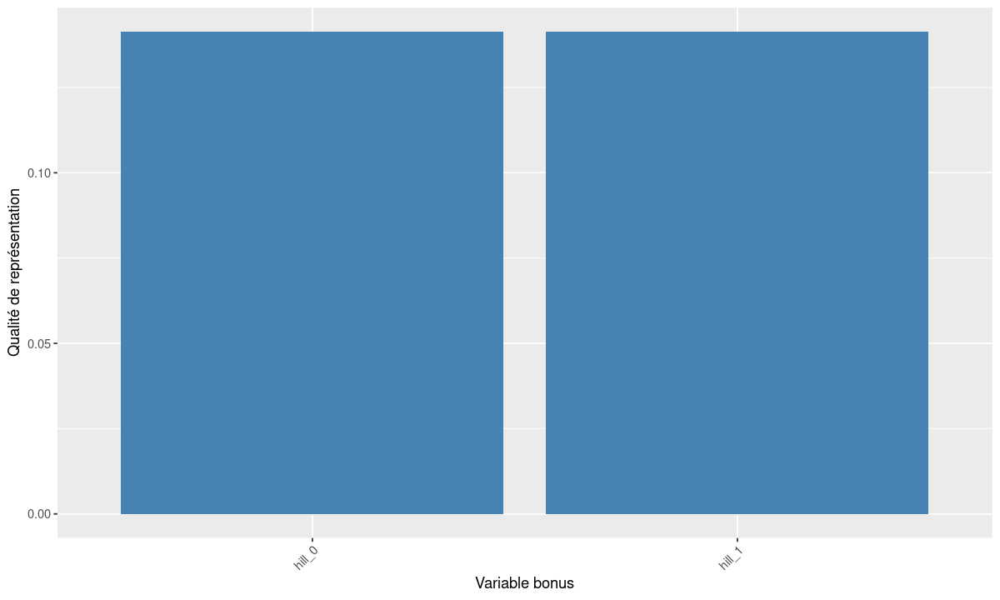

In [67]:
df = data.frame(rowSums(res.mca$quali.sup$cos2[,c(1:2)]))
colnames(df) = "quality"
df = df %>% rownames_to_column()
ggplot(df, aes(x = reorder(rowname, quality), y = quality)) +
  geom_col(fill='steelblue')  +
  rotate_x_text(angle = 45) +
  labs(x="Variable bonus", y="Qualité de représentation")

Les deux modalités de bonus ont la même qualité de représentation qui est de l'ordre de 0.15. On peut consider que la qualité de leur représentation est acceptable.

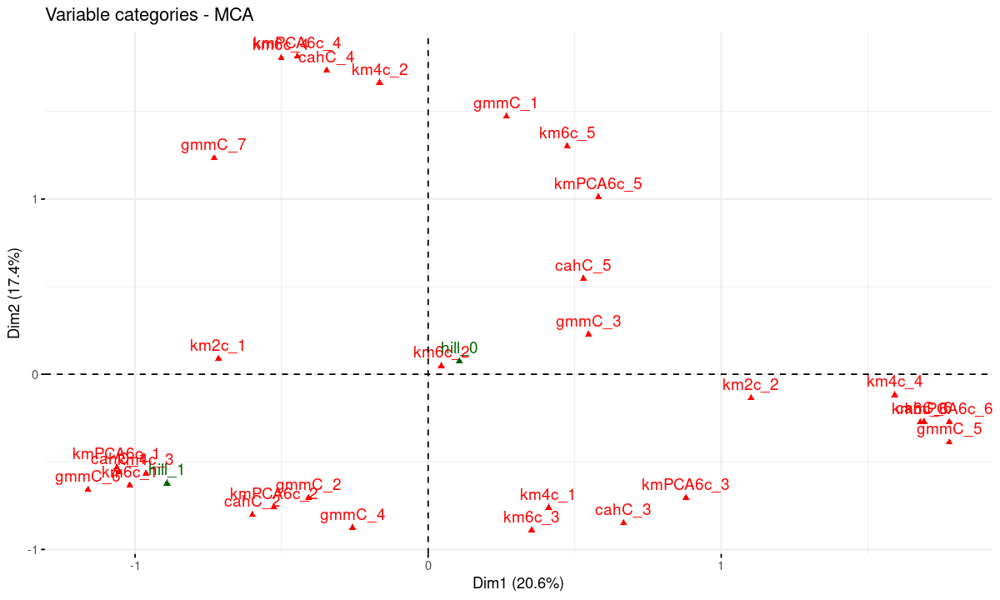

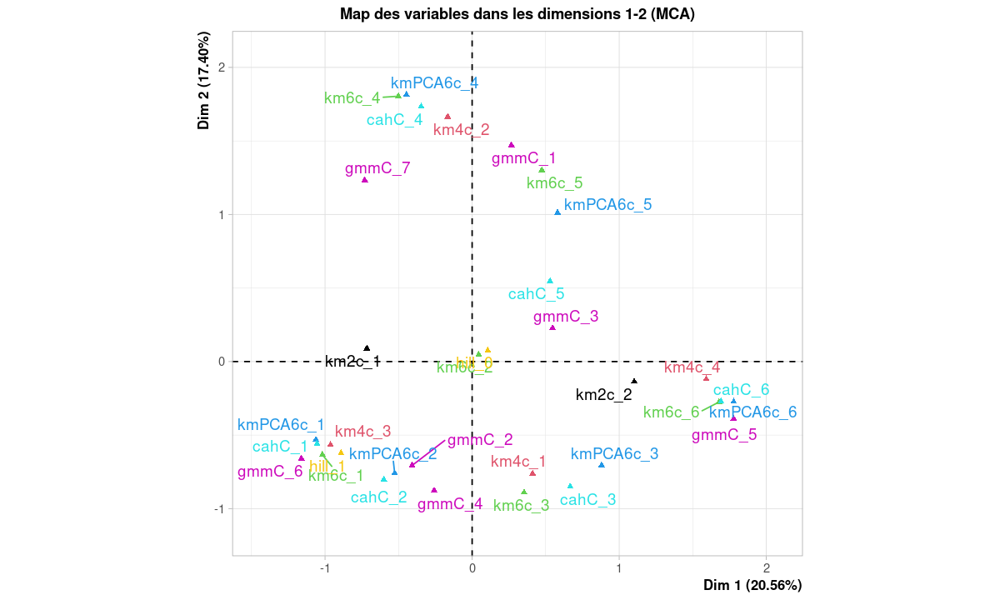

In [68]:
# affichage des modalités des variables + variable bonus
fviz_mca_var(res.mca)
plot(res.mca, invisible="ind",, title="Map des variables dans les dimensions 1-2 (MCA)",
     hab = "quali")

On remarque qu'il y a un regroupement de clusters autour de la modalité Bonus=1. Il y a donc une classe pour chaque méthode qui correspond aux stations situées en altitude.  En rajoutant la variable hill comme variable supplémentaire, nous vérifions que même si nos classifications n'exploitent pas cette informaton, elles arrivent à la retrouver. C'est donc une manière de confirmer que nos méthodes isolent bien des comportements.

**En reflexion**

## MCA sur le jeu de données complets

La MCA est une technique qui s'applique aux variables qualitatives. Afin de visualiser les stations dans un espace de MCA, tout en exploitant toute l'information disponible, nous allons seuiller les niveaux de chargements pour les transformer en variables qualitatives : le niveau a pour les niveaux de chargements inférieurs au quantile d'ordre 1/3 de loading, le niveau b pour un niveau de chargement entre le quantile d'ordre 1/3 et 2/3 et le niveau c sinon. Nous allons également utiliser la variable Bonus.

In [69]:
# séparation des données selon les trois quantiles
x=loading
Xcat=data.frame(hill=factor(velib$bonus,label=c("nohill","hill")))
day=8:19
night=c(1:7,20:24)
breaks= c(-0.01,quantile(x,1/3),quantile(x,2/3),1.01)
labels=letters[1:(length(breaks)-1)]
for (i in 1:7){
    newCol <- rowMeans(x[,day+(i-1)*24])
     #breaks= c(-0.01,quantile(newCol,1/3),quantile(newCol,2/3),1.01)
    newCol=cut(newCol,breaks=breaks,labels=labels)
    newName=paste('day',i,sep='')
    Xcat=cbind(Xcat,newCol)
    names(Xcat)[ncol(Xcat)]=newName
    }
for (i in 1:7){
    newCol <- rowMeans(x[,night+(i-1)*24])
    #breaks= c(-0.01,quantile(newCol,1/3),quantile(newCol,2/3),1.01)
    newCol=cut(newCol,breaks=breaks,labels=labels)
    newName=paste('night',i,sep='')
    Xcat=cbind(Xcat,newCol)
    names(Xcat)[ncol(Xcat)]=newName
    }

In [70]:
# affichage des premières lignes de notre nouveau dataframe

head(Xcat)

,hill,day1,day2,day3,day4,day5,day6,day7,night1,night2,night3,night4,night5,night6,night7
,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>
1,nohill,a,b,b,b,b,b,b,b,b,c,c,c,b,b
2,nohill,a,b,b,b,b,b,b,c,c,c,c,c,c,b
3,nohill,b,c,b,b,c,b,b,b,c,b,b,c,b,b
4,nohill,c,c,b,c,c,b,c,c,a,a,a,a,b,c
5,nohill,c,c,c,c,c,b,b,c,b,b,b,b,b,b
6,nohill,a,b,b,b,b,c,b,b,c,b,b,b,c,b


In [71]:
# application de la MCA sur notre nouveau dataframe
res.mca = MCA(Xcat, graph=FALSE,ncp=8)

,eigenvalue,percentage of variance,cumulative percentage of variance
dim 1,0.48236673,24.950003,24.95000
dim 2,0.23745651,12.282233,37.23224
dim 3,0.20819097,10.768499,48.00074
dim 4,0.13835044,7.156057,55.15679
dim 5,0.11155179,5.769920,60.92671
dim 6,0.06685583,3.458060,64.38477


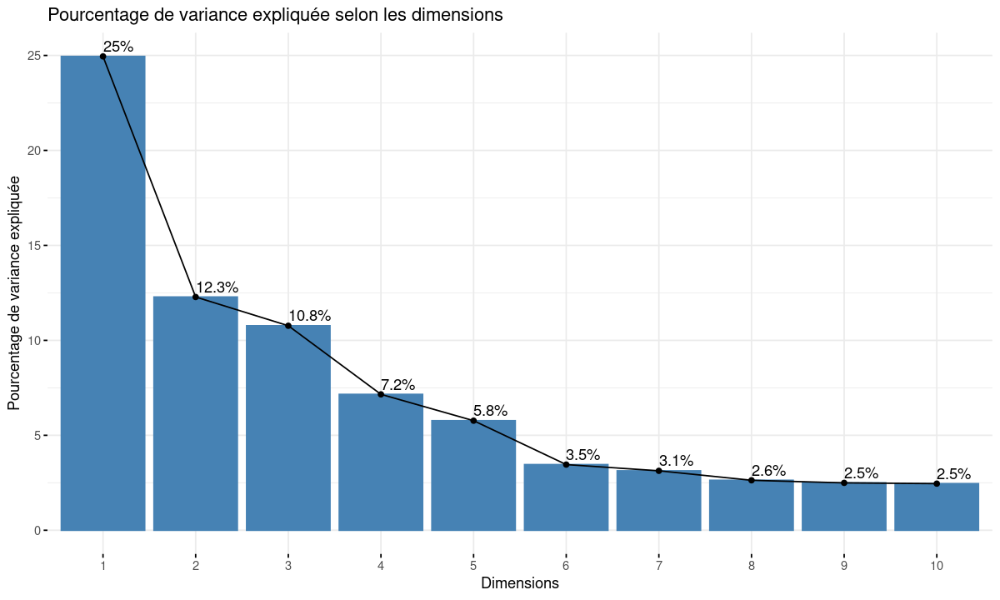

In [72]:
head(res.mca$eig)

fviz_screeplot(res.mca, addlabels=TRUE, ylab="Pourcentage de variance expliquée", title="Pourcentage de variance expliquée selon les dimensions")

Nous allons également garder deux dimensions pour expliquer environ 40% de la variance totale.

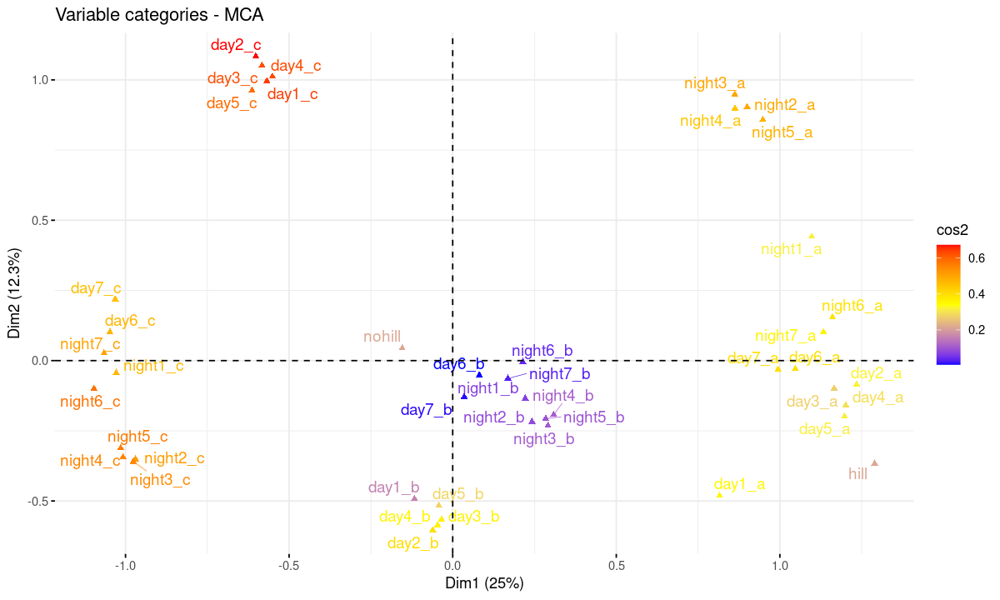

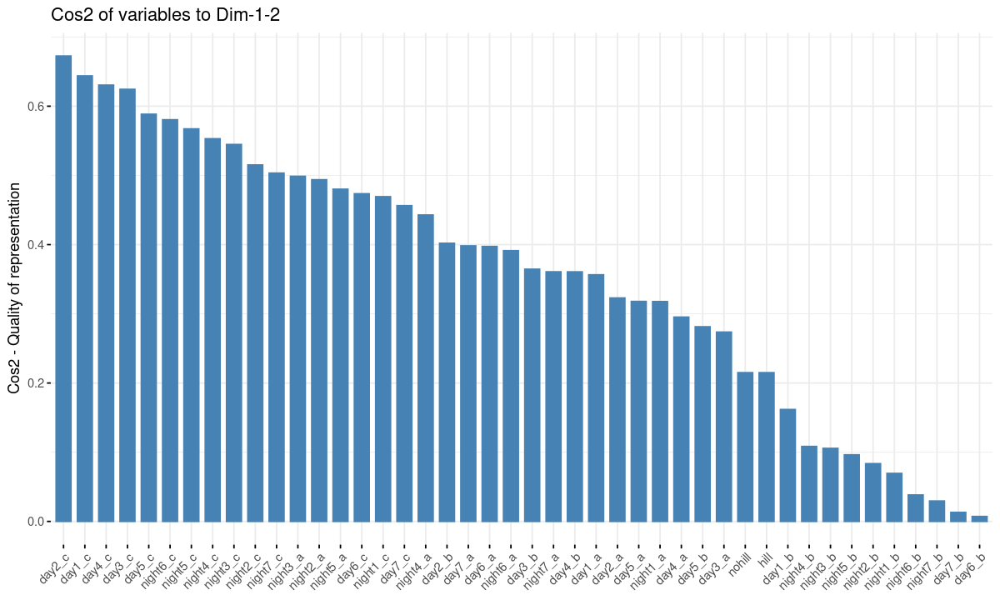

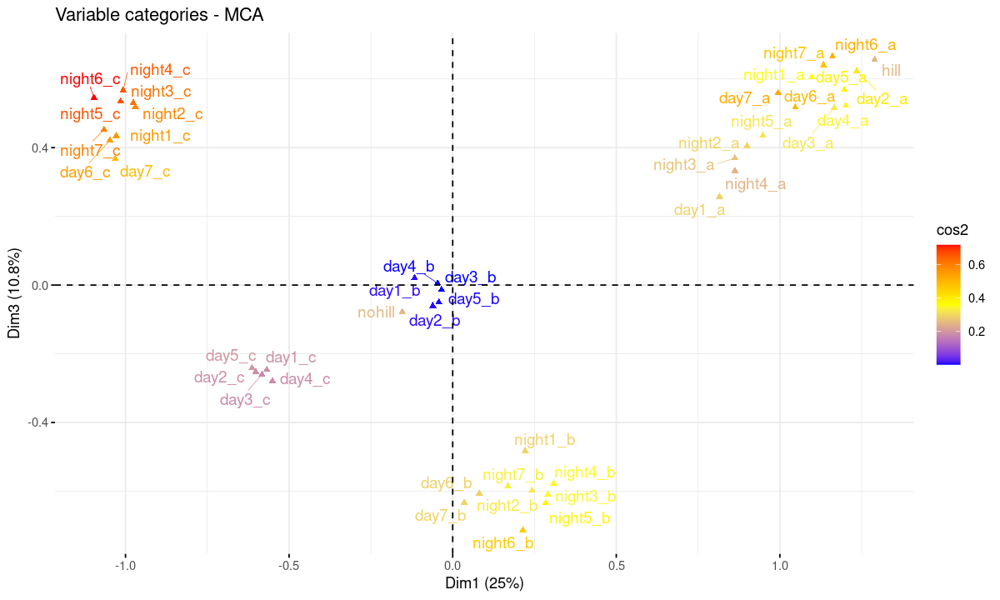

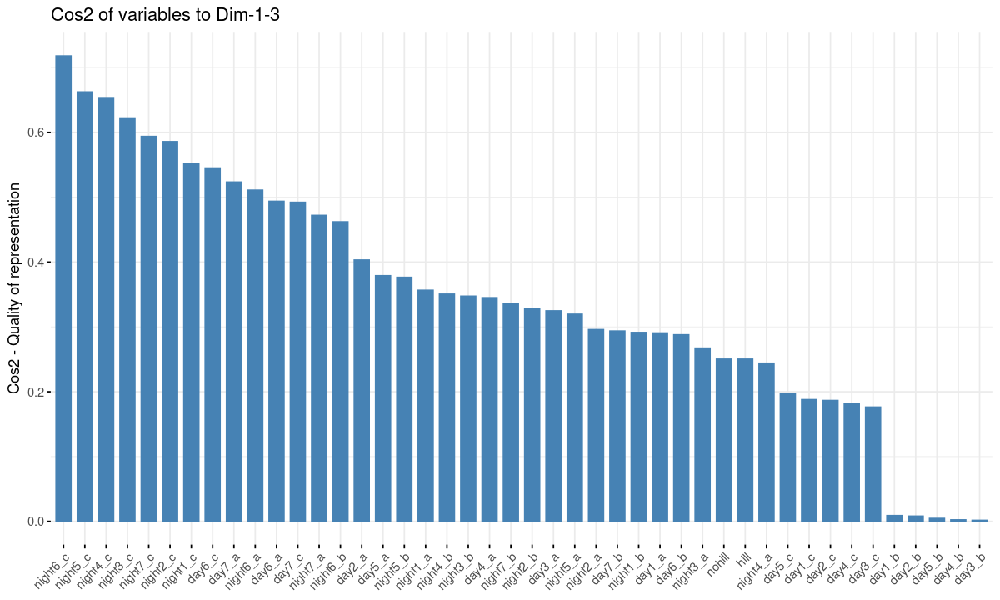

In [73]:
# affichage des modalités des variables dans le plan 1-2 de la MCA
fviz_mca_var(res.mca, col.var = "cos2",
             gradient.cols = c("blue", "yellow", "red"), 
             repel = TRUE,axes = c(1,2))


# Cos2 des variables sur Dim.1 et Dim.2
fviz_cos2(res.mca, choice = "var", axes = 1:2)


# affichage des modalités des variables dans le plan 1-3 de la MCA
fviz_mca_var(res.mca, col.var = "cos2",
             gradient.cols = c("blue", "yellow", "red"), 
             repel = TRUE,axes = c(1,3))
# Cos2 des variables sur Dim.1 et Dim.3
fviz_cos2(res.mca, choice = "var", axes =c(1,3))



On remarque que les modalités avec une mauvaise qualité de représentation sont celles qui correspondent à la modalité b. Ce qui fait sens puisque cette modalité représente un entre-deux entre un taux de remplissage élevé ou non.

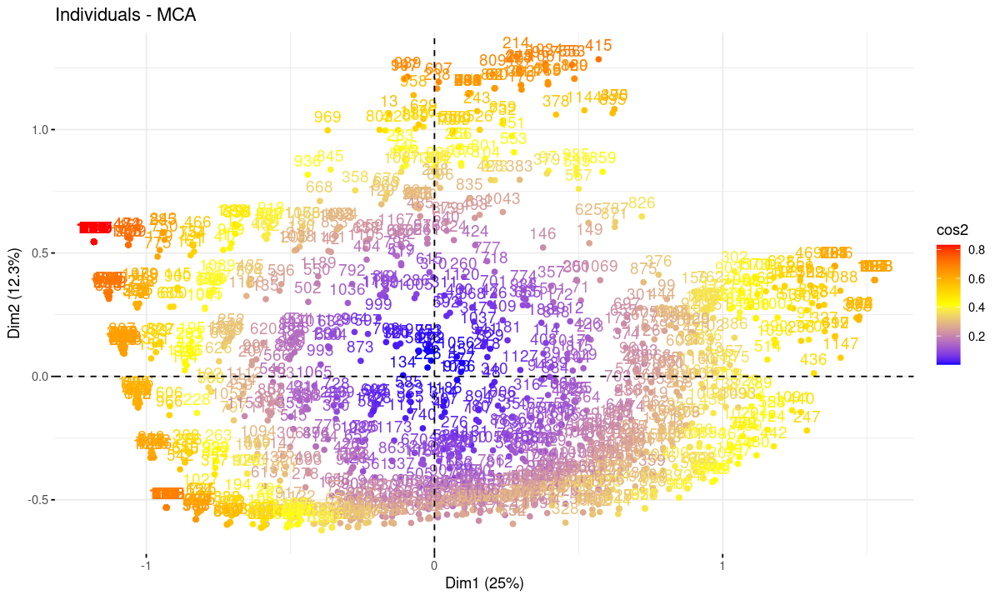

In [74]:
# graph des individus colorié selon cos2
fviz_mca_ind(res.mca, col.ind = "cos2",
             gradient.cols = c("blue", "yellow", "red"))


On remarque également sur le graphe des individus que la qualité de représentation de ceux-ci n'est pas uniforme. Il faudra donc se référer aux points dont la qualité de représentation est acceptable dans notre analyse. 

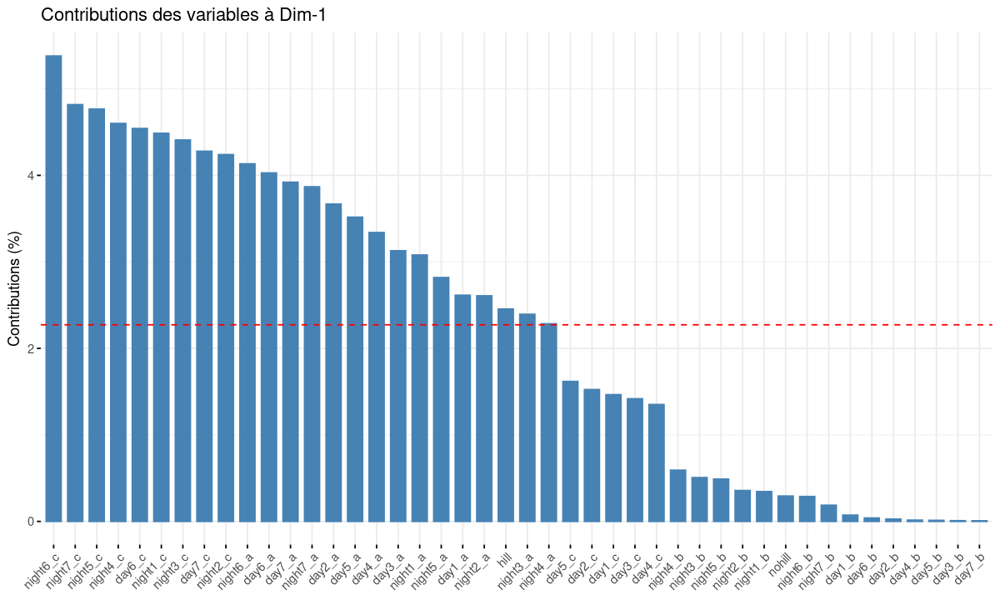

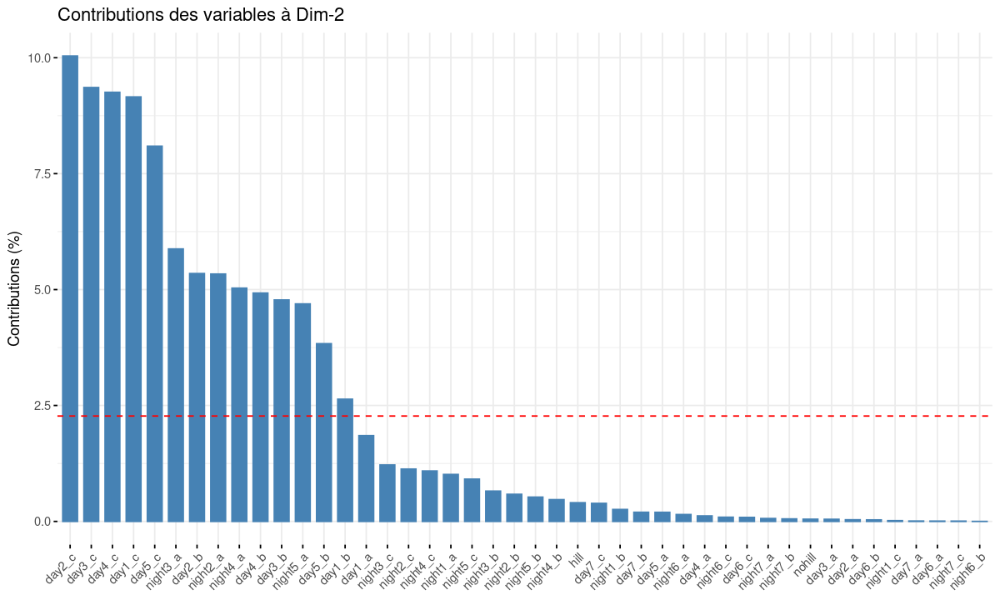

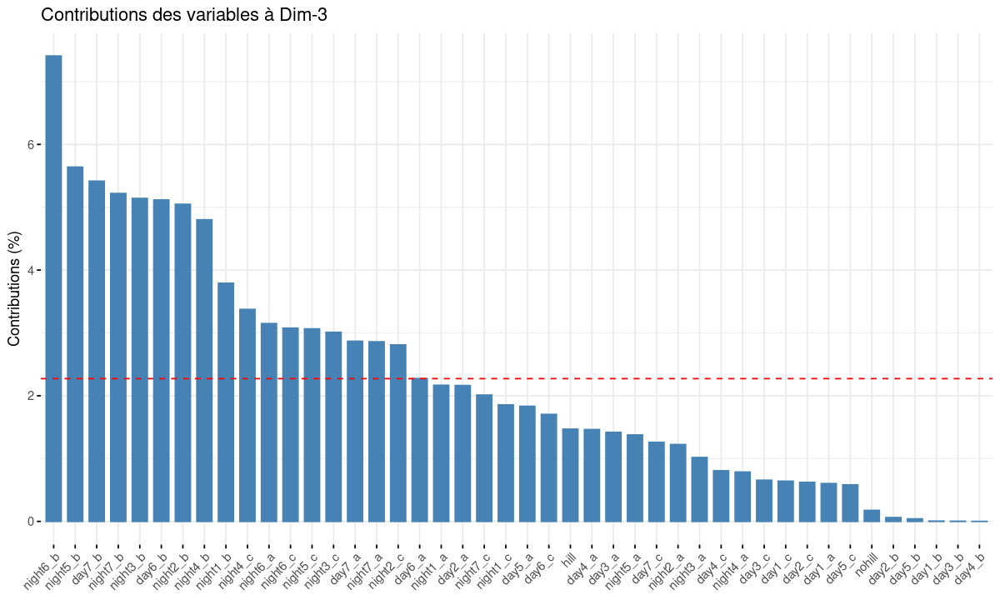

In [75]:
# contributions
fviz_contrib(res.mca, choice="var", axes=1, title="Contributions des variables à Dim-1")

fviz_contrib(res.mca, choice="var", axes=2,, title="Contributions des variables à Dim-2")
fviz_contrib(res.mca, choice="var", axes=3,, title="Contributions des variables à Dim-3")

Les variables qui contribuent le plus à la  dimension 1 sont les variables de modalité a ou c. De plus, on a remarqué que les variables de modalité a (chargement faible) sont correlés positivement à la dimension 1 tandis que les variables de modalité c sont liées négativement à la dimension 1. On peut donc dire que l'axe 1 représente le niveau de remplissage des stations (stations les plus remplies à gauche et les moins remplies à droite).

La dimension 2 vient rajouter la nuance du jour et de la nuit. 

**En effet, les modalités qui contribuent le plus à cet axe sont les jours et nuits ouvrés, qui sont soit vides soit remplies.** 

La dimension 2 fait donc la distinction entre les stations vides le jour et remplies la nuit (du lundi au vendredi) ou le contraire. C'est donc une dimension liée aux mobilités associées aux stations (si un vélo est emprunté pour aller au travail ou pour se distraire par exemple)


Au vu des modalités qui contribuent à la dimension 3, celle-ci apporte la nuance du week-end.

Warning message:
“ggrepel: 19 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


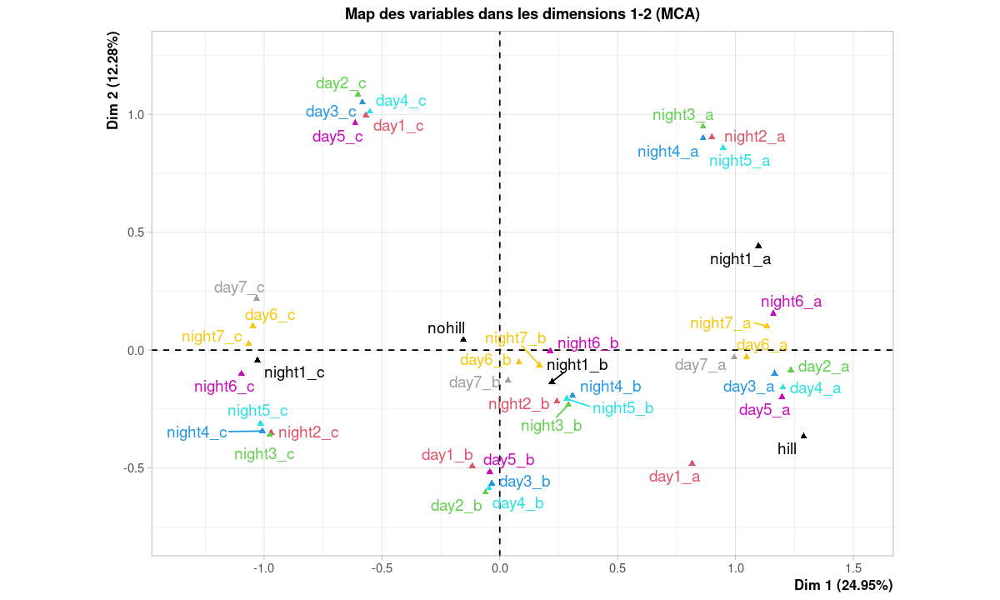

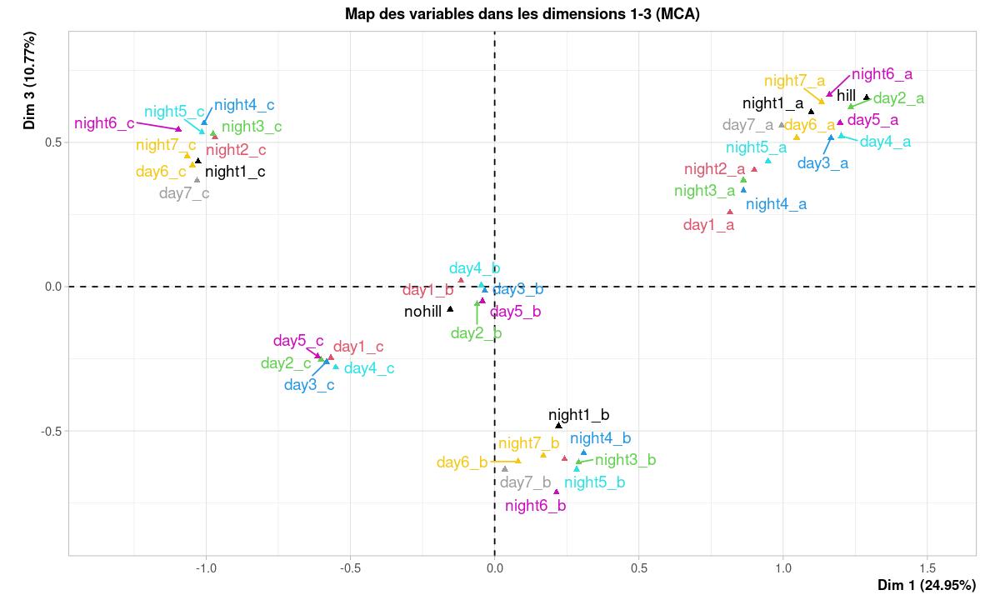

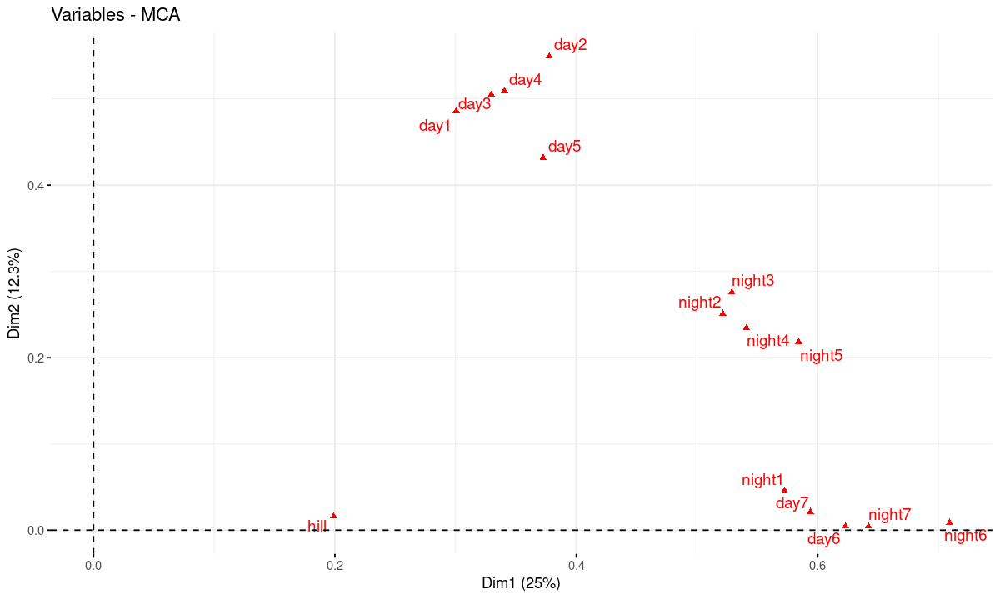

In [76]:
plot(res.mca, invisible="ind", title="Map des variables dans les dimensions 1-2 (MCA)",
     hab = "quali",axes=c(1,2))
plot(res.mca, invisible="ind", title="Map des variables dans les dimensions 1-3 (MCA)",
     hab = "quali",axes=c(1,3))
# Correlation avec les axes 1-2
fviz_mca_var(res.mca,choice="mca.cor", repel=TRUE)



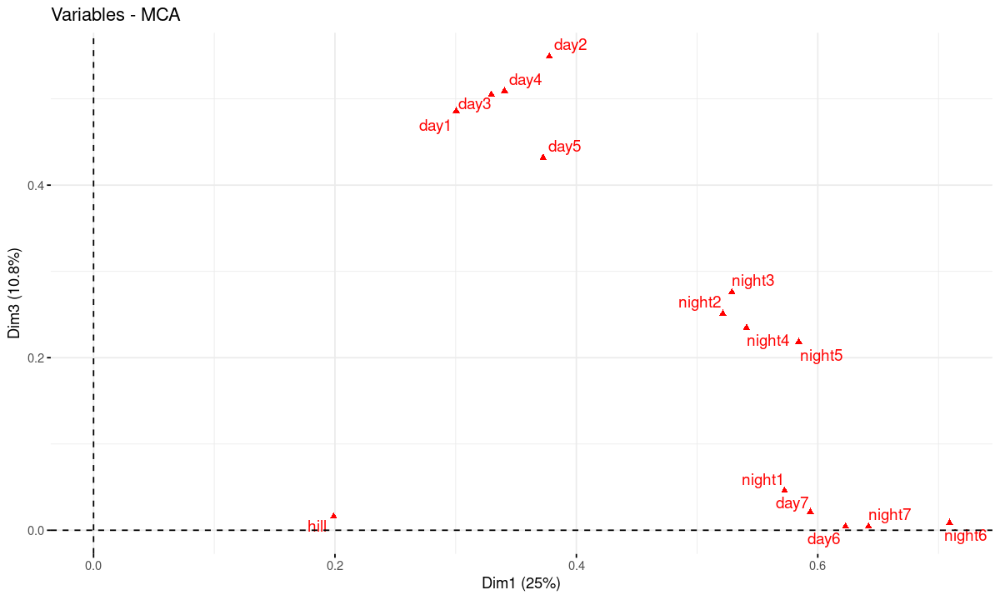

In [77]:
# Correlation avec les axes 1-3
fviz_mca_var(res.mca,choice="mca.cor", repel=TRUE,axes=c(1,3))

On remarque un effet cluster des modalités associées au même niveau de remplissage. Les variables correspondant aux jours ouvrés se regroupent, de même pour les variables liées aux weekends. La MCA sur les 168 variables seuillées confirme donc que les stations peuvent être classifiées suivant le contraste entre leur niveau de remplissage le jour/nuit et le contraste entre leur niveau de remplissage jours ouvrés/weekend. 


Notre intuition lors de l'analyse exploratoire est également vérifiée: les stations situées sur une colline sont moyennement remplies.
Au vu des regroupements de modalités obtenus, on pourrait proposé une classification en 4 clusters: 
- Les stations vides le jour et remplies la nuit
- Les stations remplies le jour et vides la nuit
- Les stations 

[1] "GMM"


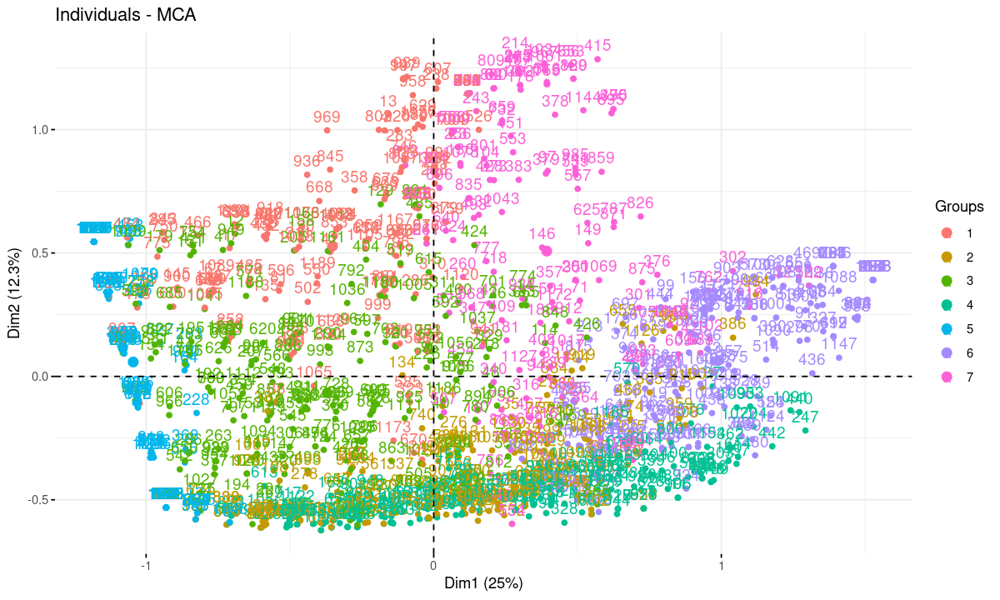

In [78]:
# affichage des individus selon leur cluster dans le cas GMM
print("GMM")
fviz_mca_ind(res.mca, habillage=as.factor(resGMM$classification))


[1] "kMEANS SANS ACP"


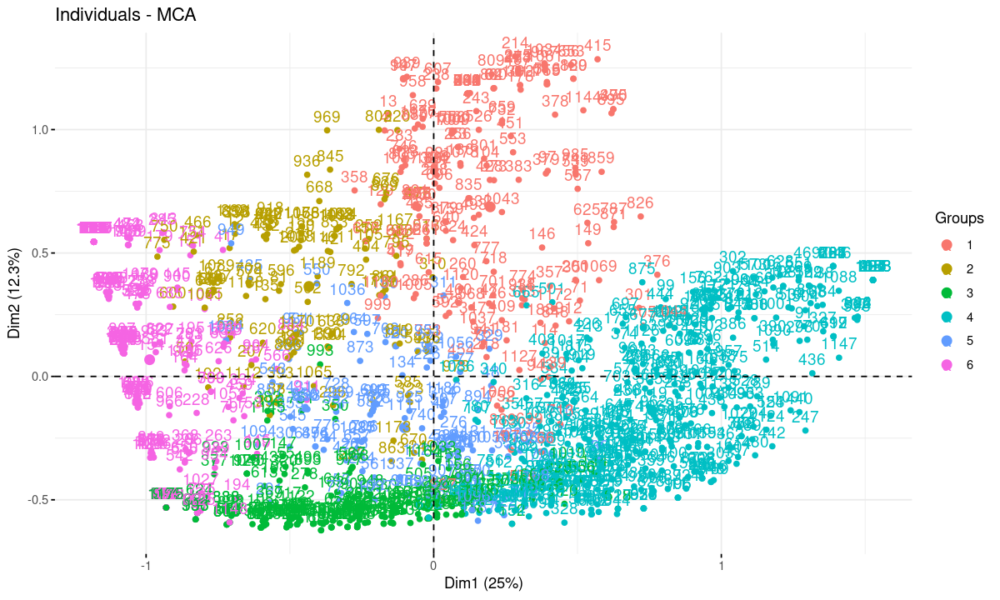

In [79]:
# affichage des individus selon leur cluster dans le cas k-means sans ACP
print("kMEANS SANS ACP")
fviz_mca_ind(res.mca, habillage=as.factor(reskmeans3$cluster))

[1] "kMEANS AVEC ACP"


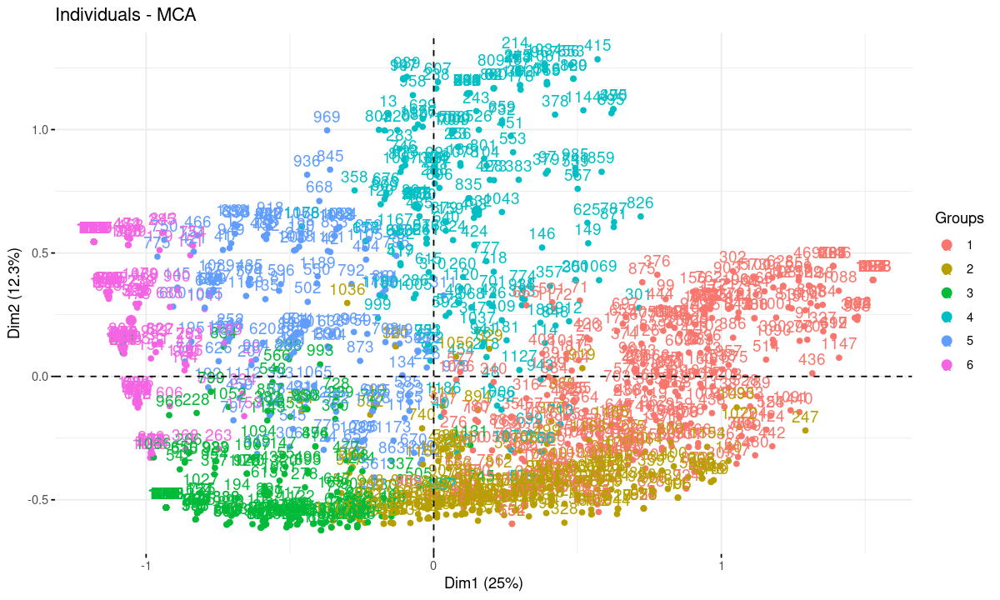

In [80]:
# affichage des individus selon leur cluster dans le cas k-means avec ACP
print("kMEANS AVEC ACP")  
fviz_mca_ind(res.mca, habillage=as.factor(reskmeans_pca$cluster))   

[1] "CAH"


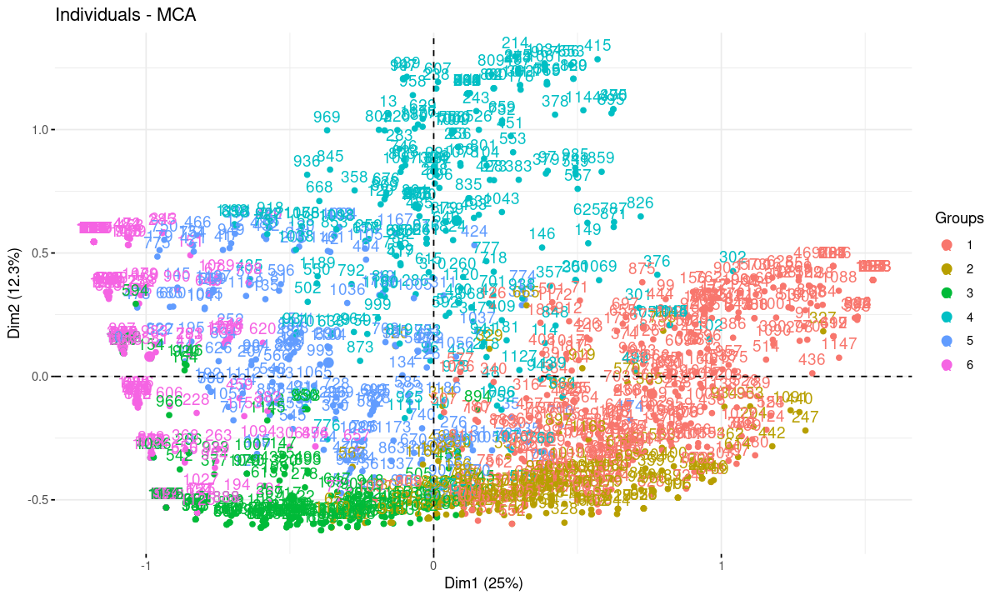

In [81]:
# affichage des individus selon leur cluster dans le cas CAH
print("CAH")  
fviz_mca_ind(res.mca, habillage=as.factor(reshclust))

On observe dans les 4 cas des clusters définis de façon plutôt similaires.

## Bilan général

Dans la première partie de ce projet, nous avons fait une analyse exploratoire du jeu de données. De cette analyse, il est ressorti que la différence de chargement entre les stations est liée à leur position géographique, qui faisait que les vélos n'étaient pas empruntés au même moment dans la journée et dans des buts différents. 

Dans la seconde partie, nous avons fait une analyse en composante principale qui nous a permis de passer de 168 variables à seulement 5 dimensions. Les deux premières dimensions (celles qui portent le plus d'inertie) permettaient d'ailleurs de faire ressortir le constraste entre des chargements faibles ou élevés et selon qu'on soit le jour et la nuit. 

Grâce à diverses méthodes et en utilisant des données dans l'espace d'ACP ou brutes, nous avons classifié les stations selon leur comportement: les stations qui sont plutôt remplies la nuit et pas le jour (1), **les stations qui ont un comportement contraire (2)**, les stations qui sont tout le temps remplies (3), les stations vides à tout moment (4), les stations qui ont un comportement moyen (5) et les stations qui sont plûtot utlisée le weekend (6). 

On peut se baser sur cette analyse pour avoir des informations sur les usagers de ces stations. Par exemple, les stations de la quatrième classe sont pour la plupart situées sur une colline. Les usagers auraient donc du mal à ramener les vélos après utilisation. 

La comparaison des différentes méthodes grâce à une MCA montre que les classifications faites sont similaires. Pour chaque méthode, il y a une classe qui correspond aux stations situées en altitude (4). 

Pour finir, en seuillant toutes les variables pour les rendre qualitatives, nous avons remarqué un regroupement selon le jour ou la nuit et selon le niveau de remplissage. Ce qui vient confirmer que la différence entre les comportements des stations s'explique par leur usage différent selon si on est le jour ou la nuit.

Il est à notifier que les analyses faites dans ce projet ne sont basées que sur les données d'une semaine. Il faudra donc les confirmer en prenant un jeu de données plus grand.